!pip install torchvision  
!pip3 install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu121  

# Поиск изображений по запросу

## Описание проекта

В фотохостинге для профессиональных фотографов «Со Смыслом» (“With Sense”) пользователи размещают свои фотографии на хостинге и сопровождают их полным описанием: указывают место съёмок, модель камеры и т. д. Отличительная особенность сервиса — описание: его может предоставить не только тот, кто размещает фотографию, но и другие пользователи портала.

### Задача проекта

В рамках проекта необходимо разработать демонстрационную версию поиска изображений по запросу. Суть поиска заключается в следующем: пользователь сервиса вводит описание нужной сцены, а сервис выводит фотографию с похожей сценой.  
Необходимо обучить модель, которая получит векторное представление изображения, векторное представление текста, а на выходе выдаст число от 0 до 1, которое покажет, насколько текст и картинка подходят друг другу.  
При решении задачи будем использовать фреймворк  Pytorch.

### Юридические ограничения

В некоторых странах, где работает компания With Sense, действуют ограничения по обработке изображений: поисковым сервисам и сервисам, предоставляющим возможность поиска, запрещено без разрешения родителей или законных представителей предоставлять любую информацию, в том числе, но не исключительно, текстов, изображений, видео и аудио, содержащие описание, изображение или запись голоса детей. Ребёнком считается любой человек, не достигший 16-ти лет.  
В With Sence строго следуют законам стран, в которых работают. Поэтому при попытке посмотреть изображения, запрещённые законодательством, вместо картинок показывается дисклеймер:

> This image is unavailable in your country in compliance with local laws
>

Однако у нас в проекте нет возможности воспользоваться данным функционалом. Поэтому все изображения, которые нарушают данный закон, необходимо удалить из обучающей выборки.
Во время тестирования модели при появлении в запросе “вредного” контента должен отображаться указанный выше дисклеймер.

### Описание данных
В файле `train_dataset.csv` находится информация, необходимая для обучения:
- имя файла изображения,
- идентификатор описания,
- текст описания Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат `<имя файла изображения>#<порядковый номер описания>`.

В папке `train_images` содержатся изображения для тренировки модели.

В файле `CrowdAnnotations.tsv` содержатся данные по соответствию изображения и описания, полученные с помощью краудсорсинга:
- имя файла изображения (колонка 1),
- идентификатор описания (колонка 2),
- доля людей, подтвердивших, что описание соответствует изображению (колонка 3),
- количество человек, подтвердивших, что описание соответствует изображению (колонка 4),
- количество человек, подтвердивших, что описание не соответствует изображению (колонка 5).

В файле `ExpertAnnotations.tsv` содержатся данные по соответствию изображения и описания, полученные в результате опроса экспертов:
- имя файла изображения (колонка 1),
- идентификатор описания (колонка 2),
- оценки трёх экспертов (колонки 3, 4, 5).  
Эксперты ставят оценки по шкале от 1 до 4, где:
- 1 — изображение и запрос совершенно не соответствуют друг другу,
- 2 — запрос содержит элементы описания изображения, но в целом запрос тексту не соответствует,
- 3 — запрос и текст соответствуют с точностью до некоторых деталей,
- 4 — запрос и текст соответствуют полностью.

В файле `test_queries.csv` находится информация, необходимая для тестирования:
- идентификатор запроса,
- текст запроса,
- имя файла релевантного изображения.
Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат `<имя файла изображения>#<порядковый номер описания>`.

В папке `test_images` содержатся изображения для тестирования модели, названия файлов содержатся в файле `test_images.csv`.

from google.colab import drive

drive.mount('/content/drive')

In [ ]:
# В проекте будем решать задачу регрессии. Импортируем необходимые библиотеки
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import notebook
from tqdm import tqdm
import re
import os
from math import ceil

# Очистка оперативной памяти
import gc

# Сохранение объектов
import joblib

# Работа с изображениями
from PIL import Image
import torchvision.models as models
from torchvision import transforms
from torchvision.models.resnet import ResNet50_Weights

# Линейная модель
from sklearn.linear_model import Ridge

# Константная модель
from sklearn.dummy import DummyRegressor

# Масштабирование признаков
from sklearn.preprocessing import MinMaxScaler

# Разделение выборки и подбор гиперпараметров
from sklearn.model_selection import GroupShuffleSplit
from sklearn.metrics import mean_absolute_error

# Нейронные сети и работа с BERT
import torch
import transformers
import torch.nn as nn

# Константы
RANDOM_STATE = 5

## Загрузка данных

In [ ]:
try:
    train_df = pd.read_csv(
        "/content/drive/MyDrive/Colab Notebooks/image_from_query/train_dataset.csv"
    )
    crowd_marks = pd.read_table(
        "/content/drive/MyDrive/Colab Notebooks/image_from_query/CrowdAnnotations.tsv",
        names=["image", "query_id", "agree_rel", "agree_cnt", "disagree_cnt"]
    )
    expert_marks = pd.read_table(
        "/content/drive/MyDrive/Colab Notebooks/image_from_query/ExpertAnnotations.tsv",
        names=["image", "query_id", "exp_1", "exp_2", "exp_3"]
    )
    test_queries = pd.read_csv(
        "/content/drive/MyDrive/Colab Notebooks/image_from_query/test_queries.csv",
        sep="|"
    )
    test_images = pd.read_csv(
        "/content/drive/MyDrive/Colab Notebooks/image_from_query/test_images.csv"
    )
except:
    train_df = pd.read_csv("train_dataset.csv")
    crowd_marks = pd.read_table(
        "CrowdAnnotations.tsv",
        names=["image", "query_id", "agree_rel", "agree_cnt", "disagree_cnt"]
    )
    expert_marks = pd.read_table(
        "ExpertAnnotations.tsv", names=["image", "query_id", "exp_1", "exp_2", "exp_3"]
    )
    test_queries = pd.read_csv("test_queries.csv", sep="|")
    test_images = pd.read_csv("test_images.csv")

In [ ]:
# Посмотрим первые строки и общие сведения
print('train_dataset')
display(train_df.head())
train_df.info()

train_dataset


,image,query_id,query_text
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image       5822 non-null   object
 1   query_id    5822 non-null   object
 2   query_text  5822 non-null   object
dtypes: object(3)
memory usage: 136.6+ KB


In [ ]:
# Посмотрим первые строки и общие сведения
print('CrowdAnnotations')
display(crowd_marks.head())
crowd_marks.info()

CrowdAnnotations


,image,query_id,agree_rel,agree_cnt,disagree_cnt
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,1.0,3,0
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,0.0,0,3
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,0.0,0,3
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,0.0,0,3
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,0.0,0,3


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 47830 entries, 0 to 47829
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   image         47830 non-null  object 
 1   query_id      47830 non-null  object 
 2   agree_rel     47830 non-null  float64
 3   agree_cnt     47830 non-null  int64  
 4   disagree_cnt  47830 non-null  int64  
dtypes: float64(1), int64(2), object(2)
memory usage: 1.8+ MB


In [ ]:
# Посмотрим первые строки и общие сведения
print('ExpertAnnotations')
display(expert_marks.head())
expert_marks.info()

ExpertAnnotations


,image,query_id,exp_1,exp_2,exp_3
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1,1,1
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1,1,2
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1,2,2
4,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1,1,2


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   image     5822 non-null   object
 1   query_id  5822 non-null   object
 2   exp_1     5822 non-null   int64 
 3   exp_2     5822 non-null   int64 
 4   exp_3     5822 non-null   int64 
dtypes: int64(3), object(2)
memory usage: 227.5+ KB


In [ ]:
# Посмотрим первые строки и общие сведения
print('test_queries')
display(test_queries.head())
test_queries.info()

test_queries


,Unnamed: 0,query_id,query_text,image
0,0,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt an...",1177994172_10d143cb8d.jpg
1,1,1177994172_10d143cb8d.jpg#1,Two boys are squirting water guns at each other .,1177994172_10d143cb8d.jpg
2,2,1177994172_10d143cb8d.jpg#2,Two boys spraying each other with water,1177994172_10d143cb8d.jpg
3,3,1177994172_10d143cb8d.jpg#3,Two children wearing jeans squirt water at eac...,1177994172_10d143cb8d.jpg
4,4,1177994172_10d143cb8d.jpg#4,Two young boys are squirting water at each oth...,1177994172_10d143cb8d.jpg


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500 entries, 0 to 499
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Unnamed: 0  500 non-null    int64 
 1   query_id    500 non-null    object
 2   query_text  500 non-null    object
 3   image       500 non-null    object
dtypes: int64(1), object(3)
memory usage: 15.8+ KB


In [ ]:
# Посмотрим первые строки и общие сведения
print('test_images')
display(test_images.head())
test_images.info()

test_images


,image
0,3356748019_2251399314.jpg
1,2887171449_f54a2b9f39.jpg
2,3089107423_81a24eaf18.jpg
3,1429546659_44cb09cbe2.jpg
4,1177994172_10d143cb8d.jpg


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   image   100 non-null    object
dtypes: object(1)
memory usage: 928.0+ bytes


In [ ]:
# удалим ничего не значащий столбец в таблице test_queries
test_queries = test_queries.drop(["Unnamed: 0"], axis=1)

## Исследовательский анализ данных


### Типы дубликаты и пропуски


Пропуски в таблицах отсутствуют, типы данных соответствуют хранимой информации. Изучим данные подробнее.

In [ ]:
# Определим количество изображений, доступных для обучения модели
try:
    train_images_dir = os.listdir(
        '/content/drive/MyDrive/Colab Notebooks/image_from_query/train_images'
    )
except:
    train_images_dir = os.listdir('train_images')
print(f'Изображений в папке для обучения: {len(train_images_dir)}')

Изображений в папке для обучения: 1000


In [ ]:
# Определим количество изображений, доступных для тестирования модели
try:
    test_images_dir = os.listdir(
        '/content/drive/MyDrive/Colab Notebooks/image_from_query/test_images'
    )
except:
    test_images_dir = os.listdir('test_images')
print(f'Изображений в папке для тестирования: {len(test_images_dir)}')

Изображений в папке для тестирования: 100


In [ ]:
# Изучим данные для обучения
print(f'Всего строк {train_df.shape[0]}')
print(f'Уникальных имён файлов в колонке image: {train_df["image"].nunique()}')
print(
    f'Несоответствий имени файла в колонке image и имени файла в папке с тренировочными изображениями: \
{len(set(train_df["image"]) ^ set(train_images_dir))}'
)
print(f'Уникальных идентификаторов описаний {train_df["query_id"].nunique()}')
print(
    f'Уникальных имён файлов в идентификаторах описаний {train_df["query_id"].str[:-2].nunique()}'
)
print(
    f'Имён файлов в колонке image, которых нет среди имён файлов в идентификаторе описания: \
{len(set(train_df["image"]) - set(train_df["query_id"].str[:-2]))}'
)
print(f'Уникальных описаний {train_df["query_text"].nunique()}')
print(f"Полных дубликатов: {train_df.duplicated().sum()}")

Всего строк 5822
Уникальных имён файлов в колонке image: 1000
Несоответствий имени файла в колонке image и имени файла в папке с тренировочными изображениями: 0
Уникальных идентификаторов описаний 977
Уникальных имён файлов в идентификаторах описаний 977
Имён файлов в колонке image, которых нет среди имён файлов в идентификаторе описания: 23
Уникальных описаний 977
Полных дубликатов: 0


In [ ]:
# Изучим данные краудсорсинга
print(f"Всего строк {crowd_marks.shape[0]}")
print(f'Уникальных имён файлов в колонке image: {crowd_marks["image"].nunique()}')
print(
    f'Несоответствий имени файла в колонке image и имени файла в папке с тренировочными изображениями: \
{len(set(crowd_marks["image"]) ^ set(train_images_dir))}'
)
print(f'Уникальных идентификаторов описаний {crowd_marks["query_id"].nunique()}')
print(
    f'Уникальных имён файлов в идентификаторах описаний {crowd_marks["query_id"].str[:-2].nunique()}'
)
print(
    f'Имён файлов в колонке image, которых нет среди имён файлов в идентификаторе описания: \
{len(set(crowd_marks["image"]) - set(crowd_marks["query_id"].str[:-2]))}'
)
print(f'Полных дубликатов: {crowd_marks.duplicated().sum()}')

Всего строк 47830
Уникальных имён файлов в колонке image: 1000
Несоответствий имени файла в колонке image и имени файла в папке с тренировочными изображениями: 0
Уникальных идентификаторов описаний 1000
Уникальных имён файлов в идентификаторах описаний 1000
Имён файлов в колонке image, которых нет среди имён файлов в идентификаторе описания: 0
Полных дубликатов: 0


In [ ]:
# Изучим данные по экспертной оценке
print(f'Всего строк {expert_marks.shape[0]}')
print(f'Уникальных имён файлов в колонке image: {expert_marks["image"].nunique()}')
print(
    f'Несоответствий имени файла в колонке image и имени файла в папке с тренировочными изображениями: \
{len(set(expert_marks["image"]) ^ set(train_images_dir))}'
)
print(f'Уникальных идентификаторов описаний {expert_marks["query_id"].nunique()}')
print(
    f'Уникальных имён файлов в идентификаторах описаний {expert_marks["query_id"].str[:-2].nunique()}'
)
print(
    f'Имён файлов в колонке image, которых нет среди имён файлов в идентификаторе описания: \
{len(set(expert_marks["image"]) - set(expert_marks["query_id"].str[:-2]))}'
)
print(f"Полных дубликатов: {expert_marks.duplicated().sum()}")

Всего строк 5822
Уникальных имён файлов в колонке image: 1000
Несоответствий имени файла в колонке image и имени файла в папке с тренировочными изображениями: 0
Уникальных идентификаторов описаний 977
Уникальных имён файлов в идентификаторах описаний 977
Имён файлов в колонке image, которых нет среди имён файлов в идентификаторе описания: 23
Полных дубликатов: 0


In [ ]:
# Изучим данные для тестирования
print(f'Всего строк {test_queries.shape[0]}')
print(f'Уникальных имён файлов в колонке image: {test_queries["image"].nunique()}')
print(
    f'Несоответствий имени файла в колонке image и имени файла в папке с тестовыми изображениями: \
{len(set(test_queries["image"]) ^ set(test_images_dir))}'
)
print(f'Уникальных идентификаторов описаний {test_queries["query_id"].nunique()}')
print(
    f'Уникальных имён файлов в идентификаторах описаний {test_queries["query_id"].str[:-2].nunique()}'
)
print(
    f'Имён файлов в колонке image, которых нет среди имён файлов в идентификаторе описания: \
{len(set(test_queries["image"]) - set(test_queries["query_id"].str[:-2]))}'
)
print(f'Уникальных описаний {test_queries["query_text"].nunique()}')
print(f'Полных дубликатов: {test_queries.duplicated().sum()}')

Всего строк 500
Уникальных имён файлов в колонке image: 100
Несоответствий имени файла в колонке image и имени файла в папке с тестовыми изображениями: 0
Уникальных идентификаторов описаний 500
Уникальных имён файлов в идентификаторах описаний 100
Имён файлов в колонке image, которых нет среди имён файлов в идентификаторе описания: 0
Уникальных описаний 500
Полных дубликатов: 0


In [ ]:
# Изучим список имён файлов тестовых изображений
print(f'Всего строк {test_images.shape[0]}')
print(f'Уникальных имён файлов: {test_images["image"].nunique()}')
print(
    f'Несоответствий имени файла в колонке image и имени файла в папке с тестовыми изображениями: \
{len(set(test_images["image"]) ^ set(test_images_dir))}'
)
print(f'Полных дубликатов: {test_queries.duplicated().sum()}')

Всего строк 100
Уникальных имён файлов: 100
Несоответствий имени файла в колонке image и имени файла в папке с тестовыми изображениями: 0
Полных дубликатов: 0


In [ ]:
# Определим количество уникальных пар изображение-описание
# в таблице с данными крайдсорсинга
print(
    f'Уникальных пар изображение-описание (краудсорсинг): \
{len(crowd_marks.groupby(["image", "query_id"]))}'
)
# в таблице с оценками экспертов
print(
    f'Уникальных пар изображение-описание (экспертная оценка): \
{len(expert_marks.groupby(["image", "query_id"]))}'
)
# в таблице для обучения
print(
    f'Уникальных пар изображение-описание (обучающие данные): \
{len(train_df.groupby(["image", "query_id"]))}'
)
# в таблице для теста
print(
    f'Уникальных пар изображение-описание (тестовые данные): \
{len(test_queries.groupby(["image", "query_id"]))}'
)

Уникальных пар изображение-описание (краудсорсинг): 47830
Уникальных пар изображение-описание (экспертная оценка): 5822
Уникальных пар изображение-описание (обучающие данные): 5822
Уникальных пар изображение-описание (тестовые данные): 500


In [ ]:
# Убедимся, что наборы пар изображение-описание в таблице
# для обучения и в таблице с оценками экспертов совпадают
print(
    f'Несовпадающих пар изображение-описание в таблице для обучения и в таблице с оценками экспертов: \
{len(set(expert_marks["image"]+expert_marks["query_id"]) ^ set(train_df["image"]+train_df["query_id"]))}'
)

Несовпадающих пар изображение-описание в таблице для обучения и в таблице с оценками экспертов: 0


In [ ]:
# Убедимся, что изображения в таблице для обучения и в таблице для теста не пересекаются
print(
    f'Совпадающих имён файлов изображений в обучающих и в тестовых данных: \
{len(set(train_df["image"]) & set(test_queries["image"]))}'
)

Совпадающих имён файлов изображений в обучающих и в тестовых данных: 0


In [ ]:
# Проверим, сколько имеется описаний в таблице с данными краудсорсинга, которых нет
# в таблице с данными для обучения
print(
    f'Идентификаторов описаний в таблице с данными краудсорсинга, которых нет в таблице для обучения: \
{len(set(crowd_marks["query_id"]) - set(train_df["query_id"]))}'
)
# в таблице с данными экспертной оценки
print(
    f'Идентификаторов описаний в таблице с данными краудсорсинга, которых нет в таблице с экспертной оценкой: \
{len(set(crowd_marks["query_id"]) - set(expert_marks["query_id"]))}'
)
# Проверим, как соотносятся наборы идентификаторов описаний в таблице для обучения
# и в таблице с данными экспертной оценки
print(
    f'Идентификаторов описаний, которых нет одновременно в таблице с данными для обучения \
и в таблице с экспертной оценкой: {len(set(train_df["query_id"]) - set(expert_marks["query_id"]))}'
)

Идентификаторов описаний в таблице с данными краудсорсинга, которых нет в таблице для обучения: 23
Идентификаторов описаний в таблице с данными краудсорсинга, которых нет в таблице с экспертной оценкой: 23
Идентификаторов описаний, которых нет одновременно в таблице с данными для обучения и в таблице с экспертной оценкой: 0


In [ ]:
# Выведем всю информацию в сводной таблице
pd.DataFrame(
    data=[
        [5822, 47830, 5822, 500, 100],
        [1000, 1000, 1000, 100, 100],
        [0, 0, 0, 0, 0],
        [977, 1000, 977, 500, "-"],
        [977, 1000, 977, 100, "-"],
        [23, 0, 23, 0, "-"],
        [977, "-", "-", 500, "-"],
        [5822, 47830, 5822, 500, "-"],
        [0, 0, 0, 0, 0],
    ],
    index=[
        "Всего строк",
        "Уникальных имён файлов в колонке image",
        "Несоответствий имени файла в колонке image и имени файла в папке с тренировочными/тестовыми изображениями",
        "Уникальных идентификаторов описаний",
        "Уникальных имён файлов в идентификаторах описаний",
        "Имён файлов в колонке image, которых нет среди имён файлов в идентификаторе описания",
        "Уникальных описаний",
        "Уникальных пар изображение-описание",
        "Полных дубликатов",
    ],
    columns=[
        "train_dataset.csv",
        "CrowdAnnotations.tsv",
        "ExpertAnnotations.tsv",
        "test_queries.csv",
        "test_images.csv",
    ],
)

,train_dataset.csv,CrowdAnnotations.tsv,ExpertAnnotations.tsv,test_queries.csv,test_images.csv
Всего строк,5822,47830,5822,500,100
Уникальных имён файлов в колонке image,1000,1000,1000,100,100
Несоответствий имени файла в колонке image и имени файла в папке с тренировочными/тестовыми изображениями,0,0,0,0,0
Уникальных идентификаторов описаний,977,1000,977,500,-
Уникальных имён файлов в идентификаторах описаний,977,1000,977,100,-
"Имён файлов в колонке image, которых нет среди имён файлов в идентификаторе описания",23,0,23,0,-
Уникальных описаний,977,-,-,500,-
Уникальных пар изображение-описание,5822,47830,5822,500,-
Полных дубликатов,0,0,0,0,0


In [ ]:
# Удалим данные краудсорсинга, для которых у нас нет текстовых описаний
print(
    f'Удаляем {crowd_marks[crowd_marks["query_id"].isin(set(crowd_marks["query_id"]) - set(train_df["query_id"]))].shape[0]} строк'
)
crowd_marks = crowd_marks[
    ~crowd_marks["query_id"].isin(
        set(crowd_marks["query_id"]) - set(train_df["query_id"])
    )
].copy()
print(f"Осталось {crowd_marks.shape[0]} строк")

Удаляем 1109 строк
Осталось 46721 строк


In [ ]:
# Посмотрим, сколько описаний имеется для каждого изображения в тестовой выборке
test_queries['query_id'].str[-2:].value_counts()

query_id
#0    100
#1    100
#2    100
#3    100
#4    100
Name: count, dtype: int64

Выводы:
- имеется 1000 изображений для обучения и 100 изображений для теста,
- между именами файлов в папках и именами файлов в таблицах имеется взаимнооднозначное соответствие,
- имена файлов в папке для обучения и в папке для теста не пересекаются,
- имеется 977 уникальных текстовых описаний для тенировочных изображений, по одному описанию для 977 из 1000 тренировочных изображений, и 1000 идентификаторов описаний,
- между идентификаторами описаний и имеющимися описаниями взаимнооднозначное соответствие, при этом для 23 идентификаторов текстовое описание отсутствует,
- в таблице с экспертной оценкой и в таблице для обучения использовано 977 идентификаторов описаний, а в таблице с данными краудсорсинга использовано 1000 идентификаторов описаний, для 23 из которых описание отсутствует,
- в таблице для обучения имеется 5822 уникальных пар изображение-описание, точно такой же набор в таблице с оценками экспертов,
- в таблице с краудсорсинговой оценкой 47830 уникальных пар изображение-описание, из которых 2329 такие  же, как в таблице с экспертной оценкой,
- для тестовых изображений имеется 500 уникальных описаний, по 5 описаний для каждого изображения.

### Определение целевой переменной

Датасет содержит экспертные оценки и краудсорсинговые оценки.  

| экспертные оценки | краудсорсинговые оценки |  
| :----------------- | :-------------------------- |
| В файле с экспертными мнениями для каждой пары изображение-текст имеются оценки от 1 до 4 от трёх специалистов. | В файле с краудсорсинговыми оценками содержится информация о доле и количестве участников, подтвердивших соответствие изображения и описания, и количестве участников, подтвердивших несоответствие изображения и описания. |  

Для решения задачи мы должны эти оценки агрегировать — превратить в одну. Модель должна возвращать на выходе условно вероятность соответствия изображения тексту, поэтому целевая переменная должна иметь значения от 0 до 1.

Для определения целевой переменной:
- выполним анализ оценок экспертов (комбинации оценок, корректность комбинаций оценок),
- выполним анализ оценок краудсорсинга (комбинации оценок, корректность комбинаций оценок),
- у пар описание-изображение, которые имеют и оценки экспертов, и оценку краудсорсинга, проанализируем взаимосвязь оценок от разных источников,
- вычислим целевую переменную для пар описание-изображение, имеющих оценку от двух источников оценки,
- вычислим целевую переменную для пар описание-изображение, имеющих только оценку экспертов,
- вычислим целевую переменную для пар описание-изображение, имеющих токлько оценку крудсорсинга.

In [ ]:
# Обозначим строки, в которых описание соответствует изображению
# в таблице с экспертными оценками
expert_marks.loc[
    expert_marks['image'] == expert_marks['query_id'].str[:-2], 'image_is_in_query_id'
] = 1
expert_marks['image_is_in_query_id'] = expert_marks['image_is_in_query_id'].fillna(0)
# в таблице с краудсорсинговыми оценками
crowd_marks.loc[
    crowd_marks['image'] == crowd_marks['query_id'].str[:-2], 'image_is_in_query_id'
] = 1
crowd_marks['image_is_in_query_id'] = crowd_marks['image_is_in_query_id'].fillna(0)
print('expert_marks')
display(expert_marks['image_is_in_query_id'].value_counts())
print('crowd_marks')
display(crowd_marks['image_is_in_query_id'].value_counts())

expert_marks


image_is_in_query_id
0.0    5664
1.0     158
Name: count, dtype: int64

crowd_marks


image_is_in_query_id
0.0    46011
1.0      710
Name: count, dtype: int64

В подавляющем большинстве случаев описание поставлено в пару не к тому изображению, для которого оно было написано.

In [ ]:
# Определим функцию, которая выводит до 6 случайных изображений с описаниями из переданного ей
# набора пар имя файла изображения-идентификатор описания
def show_sample(selected):
    if selected.shape[0] > 6:
        sample = selected.sample(6, random_state=RANDOM_STATE)
    else:
        sample = selected
    query_ids = sample['query_id'].values
    images = sample['image'].values
    fig = plt.figure(figsize=(10, round(10 * sample.shape[0] / 6)))
    for i in range(sample.shape[0]):
        fig.add_subplot(int(np.ceil(sample.shape[0] / 2)), 2, i + 1)
        query = train_df.loc[train_df['query_id'] == query_ids[i], 'query_text'].values[
            0
        ]
        try:
            image = Image.open(
                '/content/drive/MyDrive/Colab Notebooks/image_from_query/train_images/'
                + images[i]
            ).convert('RGB')
            plt.imshow(image)
        except:
            image = Image.open('train_images/' + images[i]).convert('RGB')
            plt.imshow(image)
        plt.title(query, fontsize='small')
        plt.xticks([])
        plt.yticks([])
    plt.tight_layout()
    plt.show()

#### Оценки экспертов

In [ ]:
# Добавим в таблицу с оценками экспертов столбец с комбинациями оценок экспертов
expert_marks['expert_marks'] = (
    expert_marks['exp_1'].astype('str')
    + expert_marks['exp_2'].astype('str')
    + expert_marks['exp_3'].astype('str')
)
# Проверим, как эксперты ставили оценки для случаев, где описание соответствует изображению и наоборот
expert_marks.groupby(['image_is_in_query_id', 'expert_marks'])['query_id'].agg('count')

image_is_in_query_id  expert_marks
0.0                   111             2350
                      112              965
                      113               12
                      122              677
                      123               98
                      124                2
                      133               15
                      222              580
                      223              307
                      224                2
                      233              191
                      234               26
                      244                3
                      333              214
                      334               70
                      344               49
                      444              103
1.0                   144                1
                      334                2
                      344               11
                      444              144
Name: query_id, dtype: int64

Выводы.  
Для случаев, когда в паре представлено изображение и его "родное" описание, эксперты единодушно ставят высокие оценки 3 или 4, кроме одной пары, где два эксперта поставили оценку 4, а один эксперт поставил оценку 1.

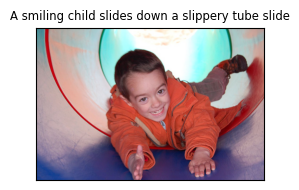

In [ ]:
# Рассмотрим изображение, по которому возникло несогласие экспертов
selected_pairs = expert_marks.loc[
    (expert_marks["expert_marks"] == "144")
    & (expert_marks["image_is_in_query_id"] == 1),
    ["query_id", "image"]
]
show_sample(selected_pairs)

Как видим, изображение точно соответствует описанию, а эксперт, который поставил оценку 1, ошибся.  
Поскольку на фото запрещённый контент, все пары изображение-описание с данным изображением удалим из обучающей выборки в дальнейшем.

Для случаев, когда в паре изображение и "чужое" описание, в большинстве случаев эксперты единодушно ставят низкие оценки 1 или 2, однако имеется значительное количество пар, когда эксперты единодушно ставят высокие оценки: 344, 444.

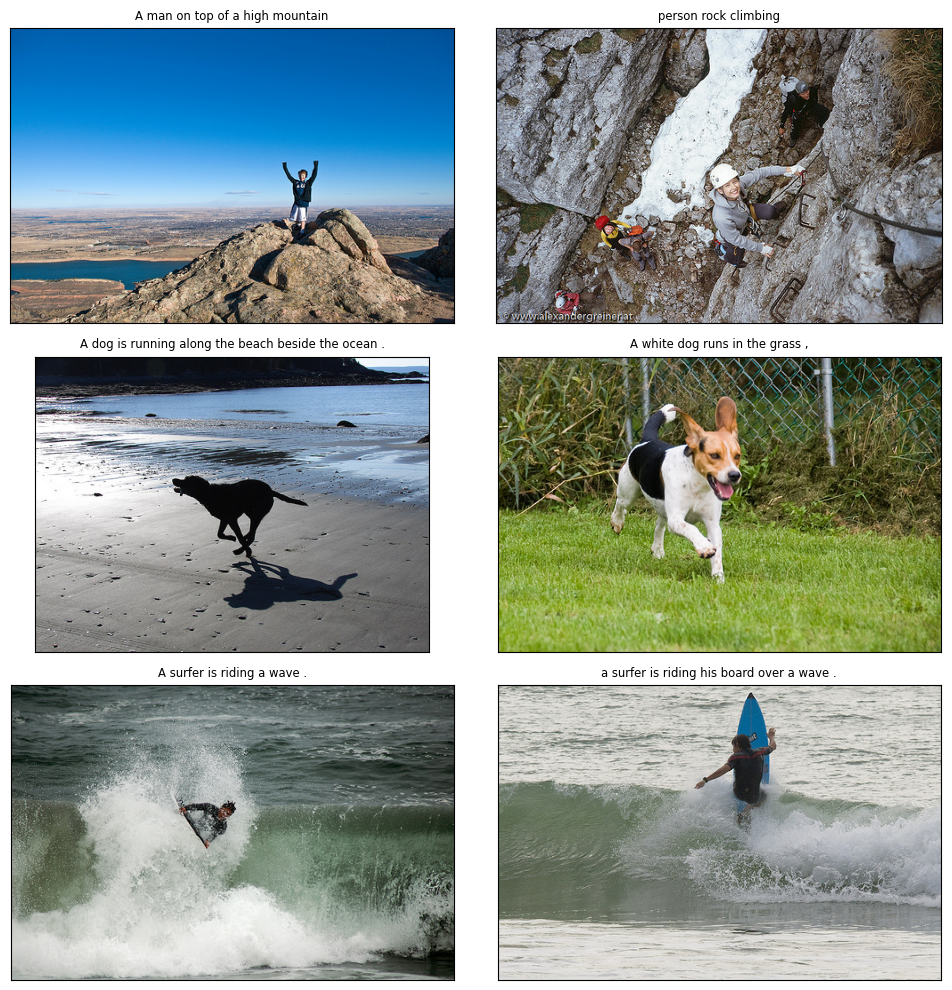

In [ ]:
# Рассмотрим изображения с высокими оценками 344, 444
selected_pairs = expert_marks.loc[
    ((expert_marks['expert_marks'] == '344') | (expert_marks['expert_marks'] == '444'))
    & (expert_marks['image_is_in_query_id'] == 0),
    ['query_id', 'image'],
]
show_sample(selected_pairs)

Оценки экспертов справедливо высокие

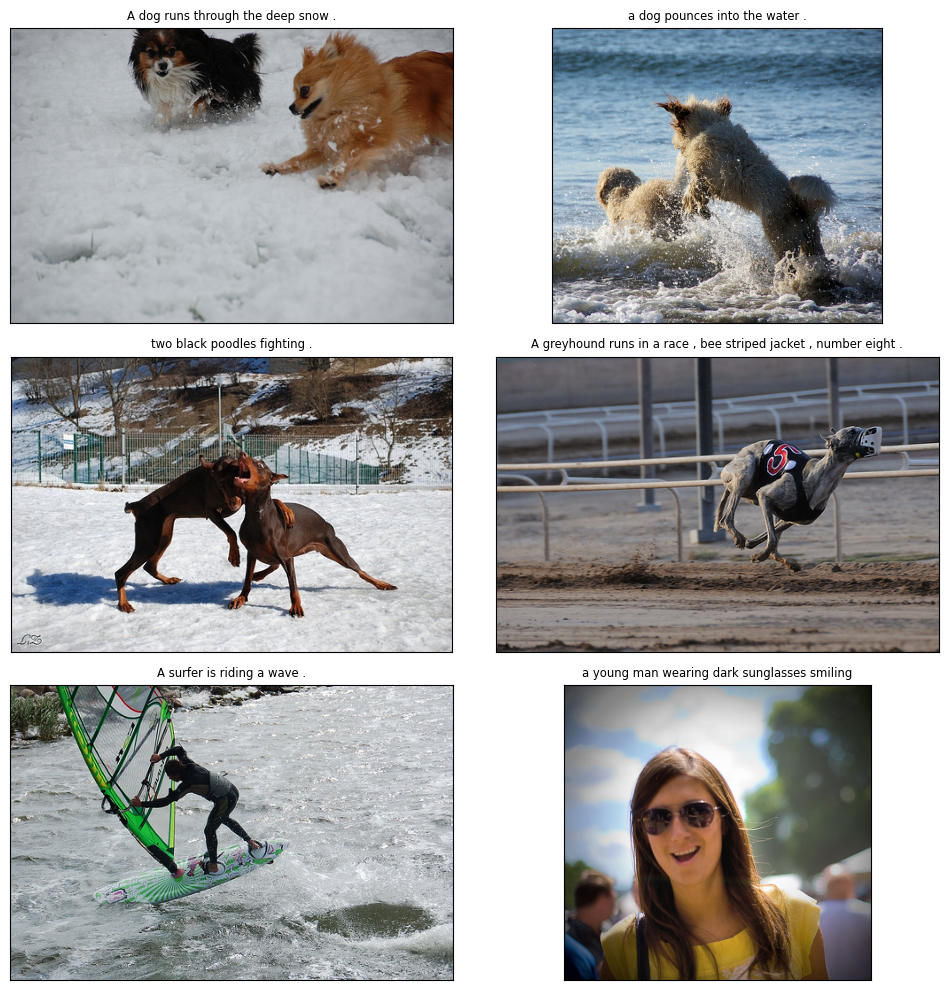

In [ ]:
# Также немало пар с оценками 333, 334. Рассмотрим изображения.
selected_pairs = expert_marks.loc[
    ((expert_marks['expert_marks'] == '333') | (expert_marks['expert_marks'] == '334'))
    & (expert_marks['image_is_in_query_id'] == 0),
    ['query_id', 'image'],
]
show_sample(selected_pairs)

В ряде случаев описание не полностью соответствует описанию, однако оценки будем считать адекватными.

Также имеются случаи, когда эксперты ставят все разные оценки или один из экспертов ставит оценку, сильно отличающуюся от оценки двух других экспертов: 113, 123, 124, 133, 224, 234, 244.  
Рассмотрим примеры изображений по описанным необычным парам.

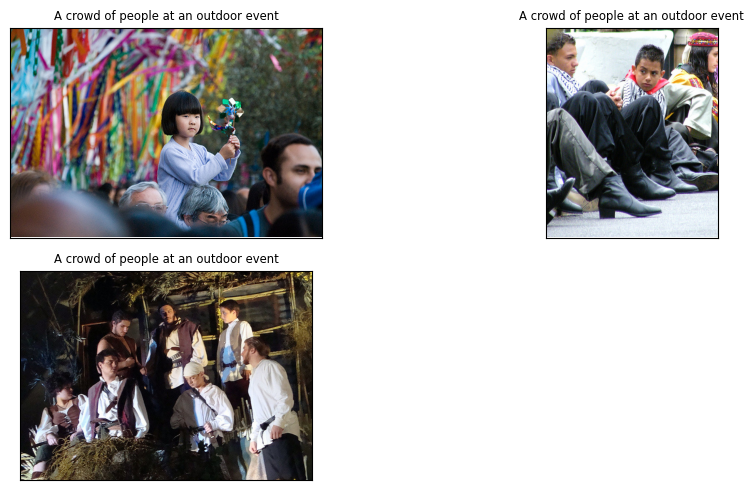

In [ ]:
# 244
selected_pairs = expert_marks.loc[
    ((expert_marks['expert_marks'] == '244'))
    & (expert_marks['image_is_in_query_id'] == 0),
    ['query_id', 'image'],
]
show_sample(selected_pairs)

Оценки будем считать адекватными, несмотря на то, что один из экпертов занизил сходство.

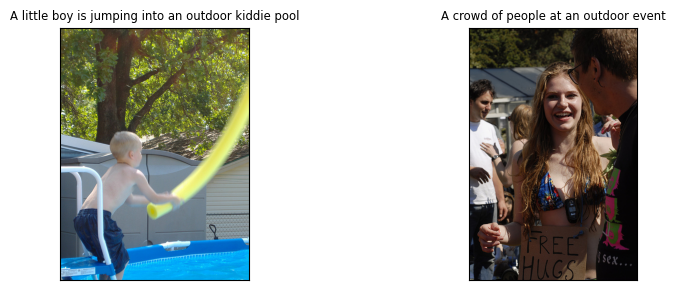

In [ ]:
# 224
selected_pairs = expert_marks.loc[
    ((expert_marks['expert_marks'] == '224'))
    & (expert_marks['image_is_in_query_id'] == 0),
    ['query_id', 'image'],
]
show_sample(selected_pairs)

Оценки ошибочны, слишком низкие, удалим такие пары изображение-описание.

In [ ]:
# Набор пар изображение-описание для удаления сохраним в переменной pairs_to_delete
pairs_to_delete = selected_pairs.copy()

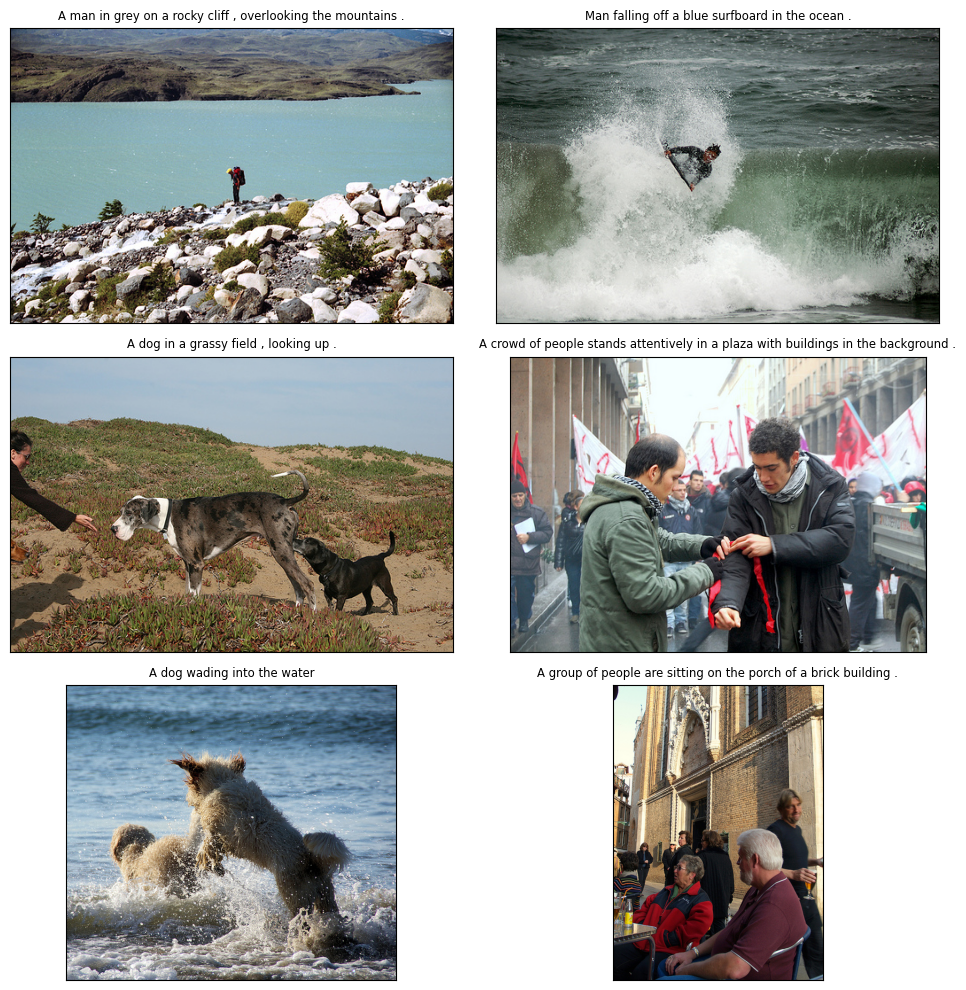

In [ ]:
# 234
selected_pairs = expert_marks.loc[
    ((expert_marks['expert_marks'] == '234'))
    & (expert_marks['image_is_in_query_id'] == 0),
    ['query_id', 'image'],
]
show_sample(selected_pairs)

Оценки адекватные.

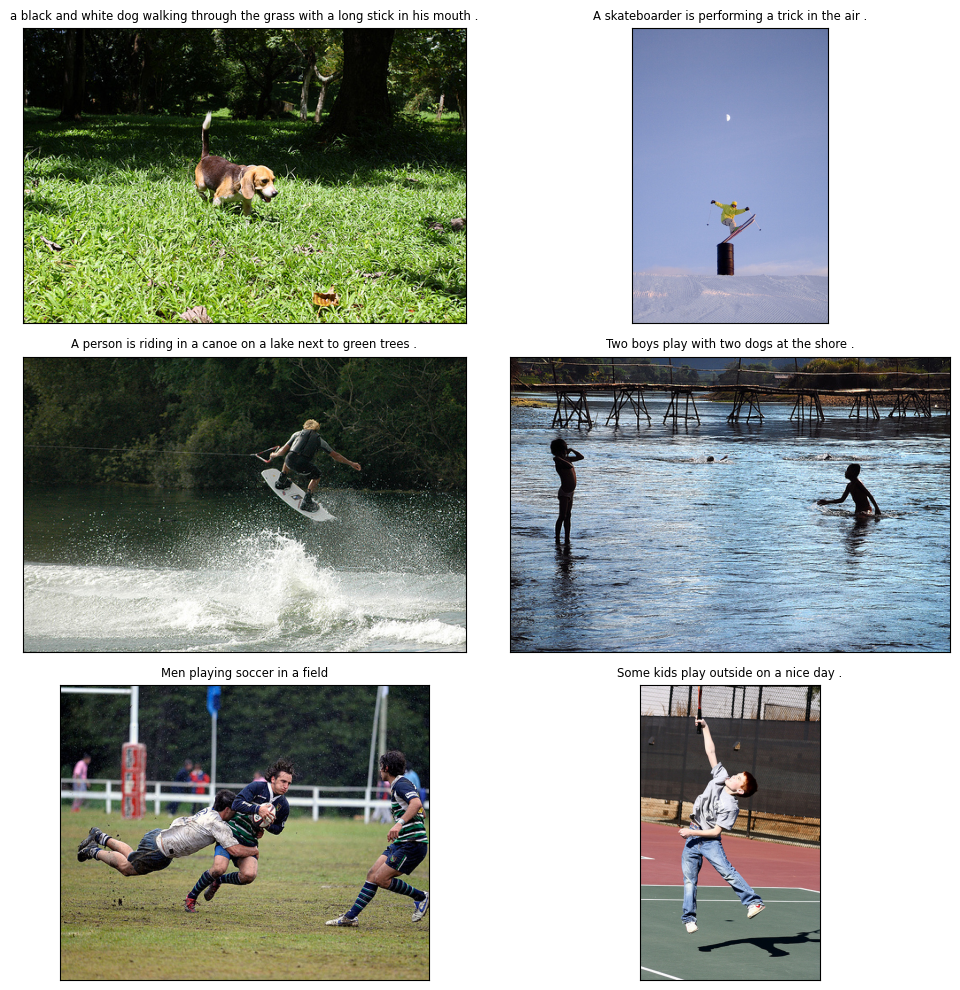

In [ ]:
# 133
selected_pairs = expert_marks.loc[
    ((expert_marks['expert_marks'] == '133'))
    & (expert_marks['image_is_in_query_id'] == 0),
    ['query_id', 'image'],
]
show_sample(selected_pairs)

Оценки адекватные.

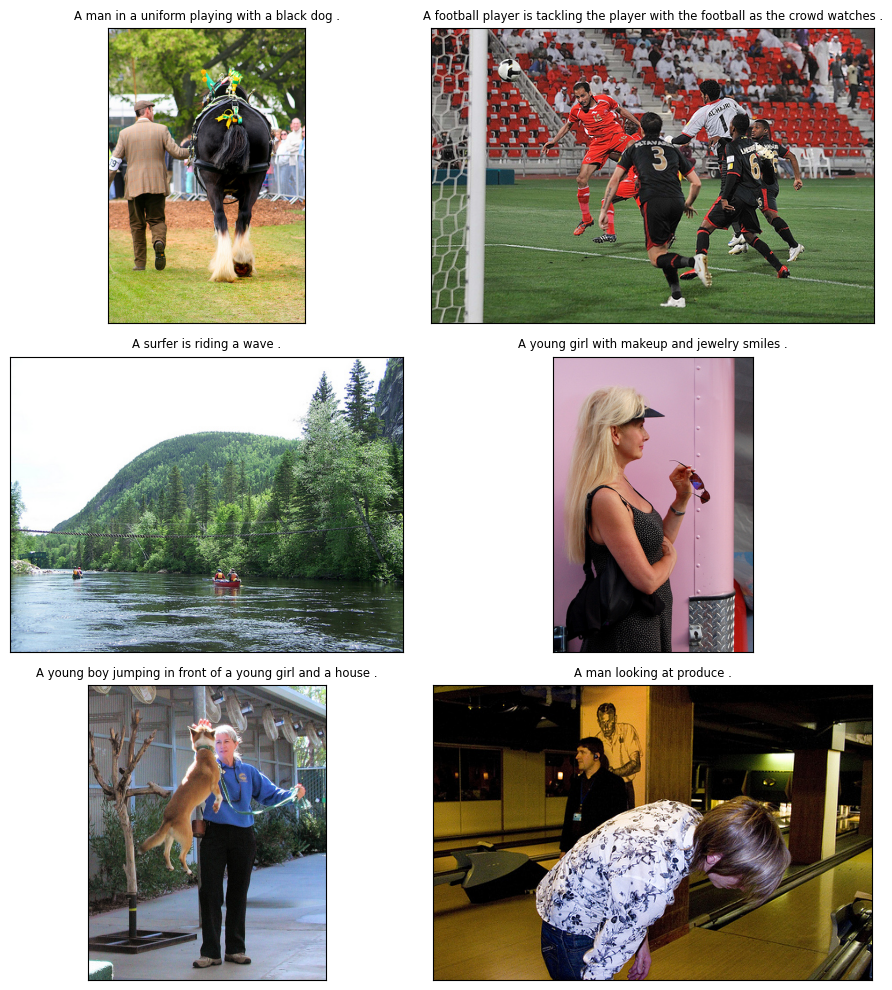

In [ ]:
# 113
selected_pairs = expert_marks.loc[
    ((expert_marks['expert_marks'] == '113'))
    & (expert_marks['image_is_in_query_id'] == 0),
    ['query_id', 'image'],
]
show_sample(selected_pairs)

Оценки адекватные.

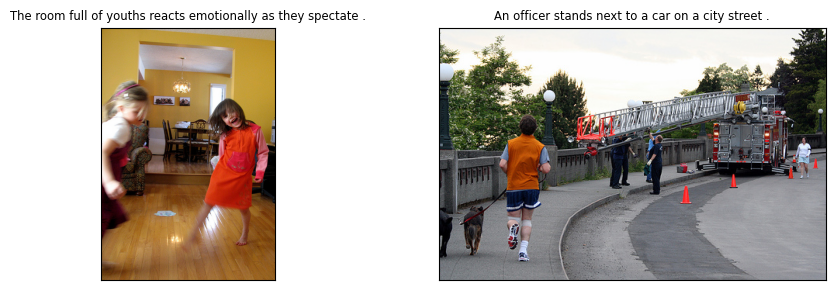

In [ ]:
# 124
selected_pairs = expert_marks.loc[
    ((expert_marks['expert_marks'] == '124'))
    & (expert_marks['image_is_in_query_id'] == 0),
    ['query_id', 'image'],
]
show_sample(selected_pairs)

Оценки ошибочны, слишком низкие, удалим такие пары изображение-описание.

In [ ]:
# Добавим пары в pairs_to_delete
pairs_to_delete = pd.concat([pairs_to_delete, selected_pairs])

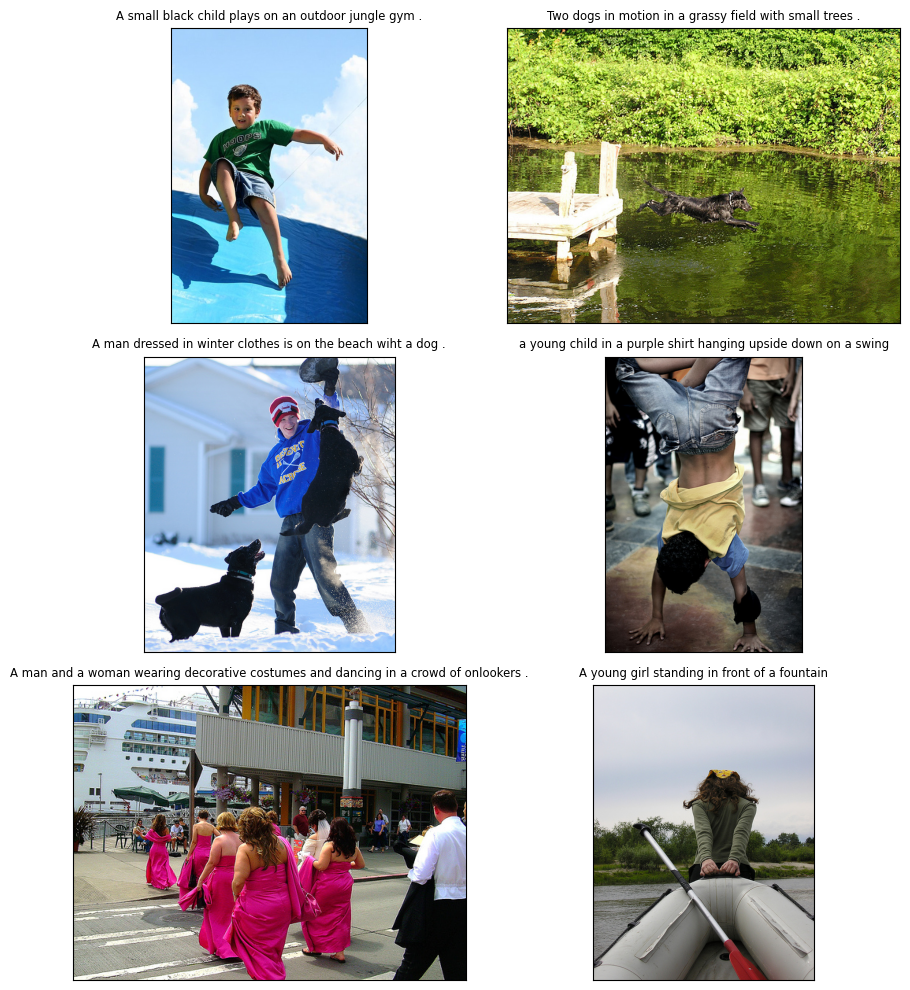

In [ ]:
# 123
selected_pairs = expert_marks.loc[
    ((expert_marks['expert_marks'] == '123'))
    & (expert_marks['image_is_in_query_id'] == 0),
    ['query_id', 'image'],
]
show_sample(selected_pairs)

Оценки адекватные. Рассмотрим теперь примеры изображений, для которых получены комбинации оценок: 111, 112, 122, 222, 223, то есть эксперты отметили несоответствие.

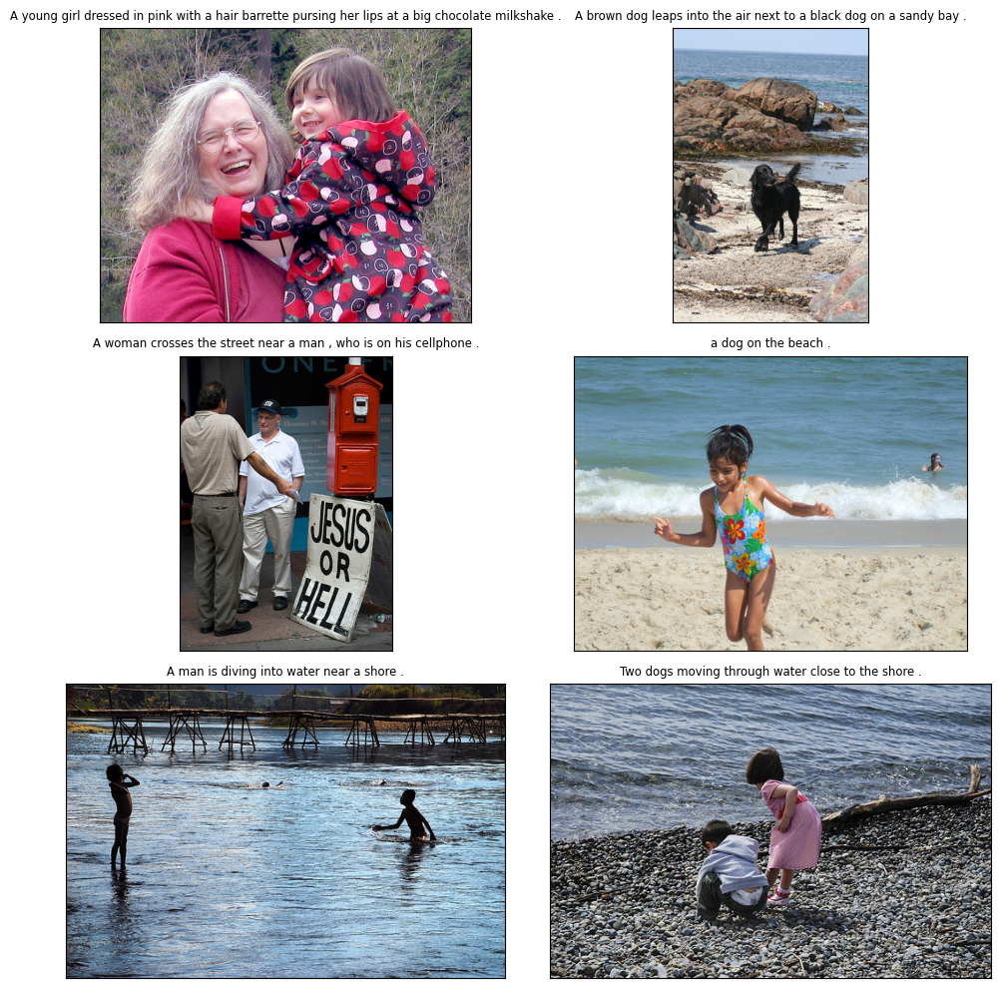

In [ ]:
# 111, 112, 122, 222, 223
selected_pairs = expert_marks.loc[
    (
        (expert_marks['expert_marks'] == '111')
        | (expert_marks['expert_marks'] == '112')
        | (expert_marks['expert_marks'] == '122')
        | (expert_marks['expert_marks'] == '222')
        | (expert_marks['expert_marks'] == '223')
    )
    & (expert_marks['image_is_in_query_id'] == 0),
    ['query_id', 'image'],
]
show_sample(selected_pairs)

Оценки адекватные. Рассмотрим оставшуюся комбинацию 233.

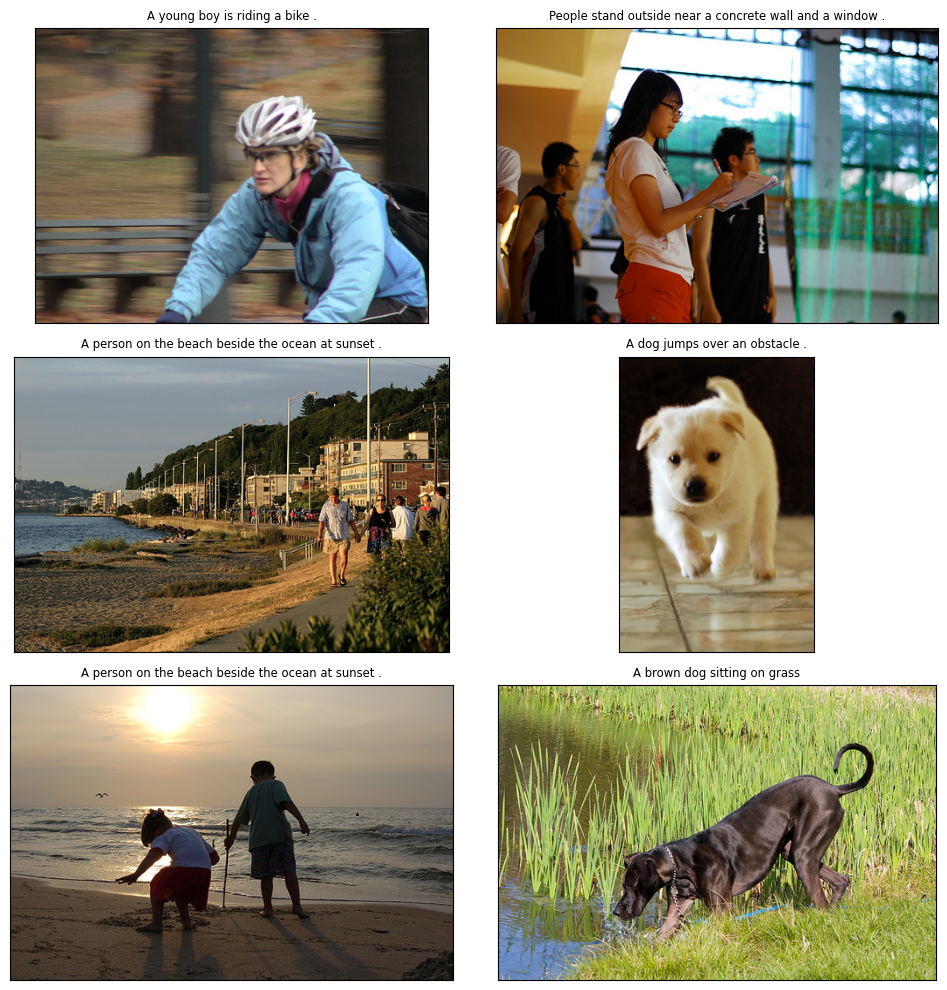

In [ ]:
# 233
selected_pairs = expert_marks.loc[
    ((expert_marks['expert_marks'] == '233'))
    & (expert_marks['image_is_in_query_id'] == 0),
    ['query_id', 'image'],
]
show_sample(selected_pairs)

Оценки адекватные. Удалим теперь все пары изображение-описание, которые ранее отметили, как подлежащие удалению.

In [ ]:
pairs_to_delete = pairs_to_delete['image'] + pairs_to_delete['query_id']
print(f'К удалению {pairs_to_delete.shape[0]} пар')
print('train_df')
was = train_df.shape[0]
print(f'Строк до удаления {was}')
train_df = train_df[
    ~((train_df['image'] + train_df['query_id']).isin(pairs_to_delete))
].copy()
print(f'Строк после удаления {train_df.shape[0]}, удалено {was - train_df.shape[0]}')
print()
print('expert_marks')
was = expert_marks.shape[0]
print(f'Строк до удаления {was}')
expert_marks = expert_marks[
    ~((expert_marks['image'] + expert_marks['query_id']).isin(pairs_to_delete))
].copy()
print(
    f'Строк после удаления {expert_marks.shape[0]}, удалено {was - expert_marks.shape[0]}'
)
print()
print('crowd_marks')
was = crowd_marks.shape[0]
print(f'Строк до удаления {was}')
crowd_marks = crowd_marks[
    ~((crowd_marks['image'] + crowd_marks['query_id']).isin(pairs_to_delete))
].copy()
print(
    f'Строк после удаления {crowd_marks.shape[0]}, удалено {was - crowd_marks.shape[0]}'
)

К удалению 4 пар
train_df
Строк до удаления 5822
Строк после удаления 5818, удалено 4

expert_marks
Строк до удаления 5822
Строк после удаления 5818, удалено 4

crowd_marks
Строк до удаления 46721
Строк после удаления 46720, удалено 1


In [ ]:
# Удалим лишние столбцы
expert_marks = expert_marks.drop(['image_is_in_query_id'], axis=1)

In [ ]:
# Преобразуем комбинации оценок экспертов в величину, которая отражает уверенность экспертов в соответствии
replace_map = {
    '111': 0,
    '112': 1,
    '113': 1,
    '122': 2,
    '222': 3,
    '123': 3,
    '223': 4,
    '133': 5,
    '233': 5,
    '333': 6,
    '234': 6,
    '334': 7,
    '144': 7,
    '244': 7,
    '344': 7,
    '444': 8,
}
expert_marks['expert_marks'] = expert_marks['expert_marks'].replace(replace_map)
expert_marks['expert_marks'].value_counts()

expert_marks
0    2350
1     977
3     678
2     677
4     307
8     247
6     240
5     206
7     136
Name: count, dtype: int64

#### Оценки участников краудсорсинга

In [ ]:
# Добавим столбец с текстом описания в таблицу с результатами крайдсорсинга
crowd_marks = crowd_marks.merge(
    train_df.groupby(['query_id'])['query_text'].agg('first').reset_index(),
    how='left',
    left_on=['query_id'],
    right_on=['query_id'],
    validate='m:1',
)
crowd_marks.head()

,image,query_id,agree_rel,agree_cnt,disagree_cnt,image_is_in_query_id,query_text
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,1.0,3,0,1.0,"A woman is signaling is to traffic , as seen f..."
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,0.0,0,3,0.0,A boy in glasses is wearing a red shirt .
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,0.0,0,3,0.0,A young boy holds onto a blue handle on a pier .
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,0.0,0,3,0.0,"A woman wearing black clothes , a purple scarf..."
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,0.0,0,3,0.0,An older woman with blond hair rides a bicycle...


In [ ]:
# Добавим в таблицу с краудсорсинговыми оценками столбец с комбинациями решений участников
crowd_marks['crowd_marks'] = crowd_marks['agree_cnt'].astype('str') + crowd_marks[
    'disagree_cnt'
].astype('str')
# Проверим, как эксперты ставили оценки для случаев, где описание
# соответствует изображению и наоборот
crowd_marks.groupby(['image_is_in_query_id', 'crowd_marks'])['query_id'].agg('count')

image_is_in_query_id  crowd_marks
0.0                   03             40099
                      04               626
                      05               163
                      06                42
                      12              2941
                      13                94
                      14                22
                      15                 3
                      21              1203
                      22                26
                      23                 8
                      24                 2
                      30               754
                      31                 7
                      32                 7
                      33                 1
                      40                 4
                      41                 3
                      42                 2
                      50                 3
1.0                   03                 2
                      12                19
                    

Выводы.  
Для случаев, когда в паре представлено изображение и его "родное" описание участники в большинстве случаев подтверждали соответствие, за исключением двух пар, когда участники единогласно отметили несоответствие, и 19 пар, когда участники большинством подтвердили несоответствие. Рассмотрим такие изображения.

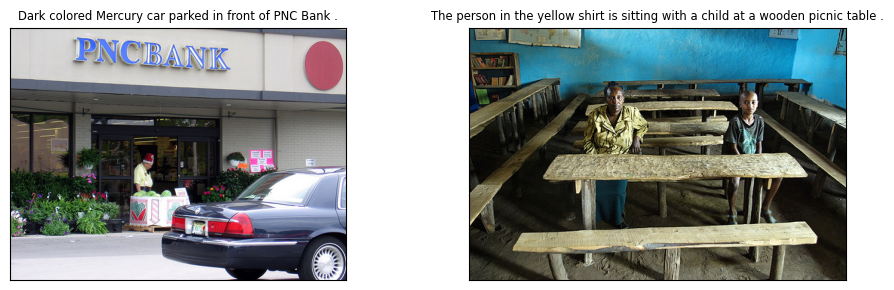

In [ ]:
# 03
selected_pairs = crowd_marks.loc[
    (crowd_marks['crowd_marks'] == '03') & (crowd_marks['image_is_in_query_id'] == 1),
    ['query_id', 'image']
]
show_sample(selected_pairs)

Как видим, изображение точно соответствует описанию, а участники, которые единогласно подтвердили несоответствие, ошиблись.
Поскольку на одном из фото запрещённый контент, все пары изображение-описание с данным изображением удалим из обучающей выборки в дальнейшем.

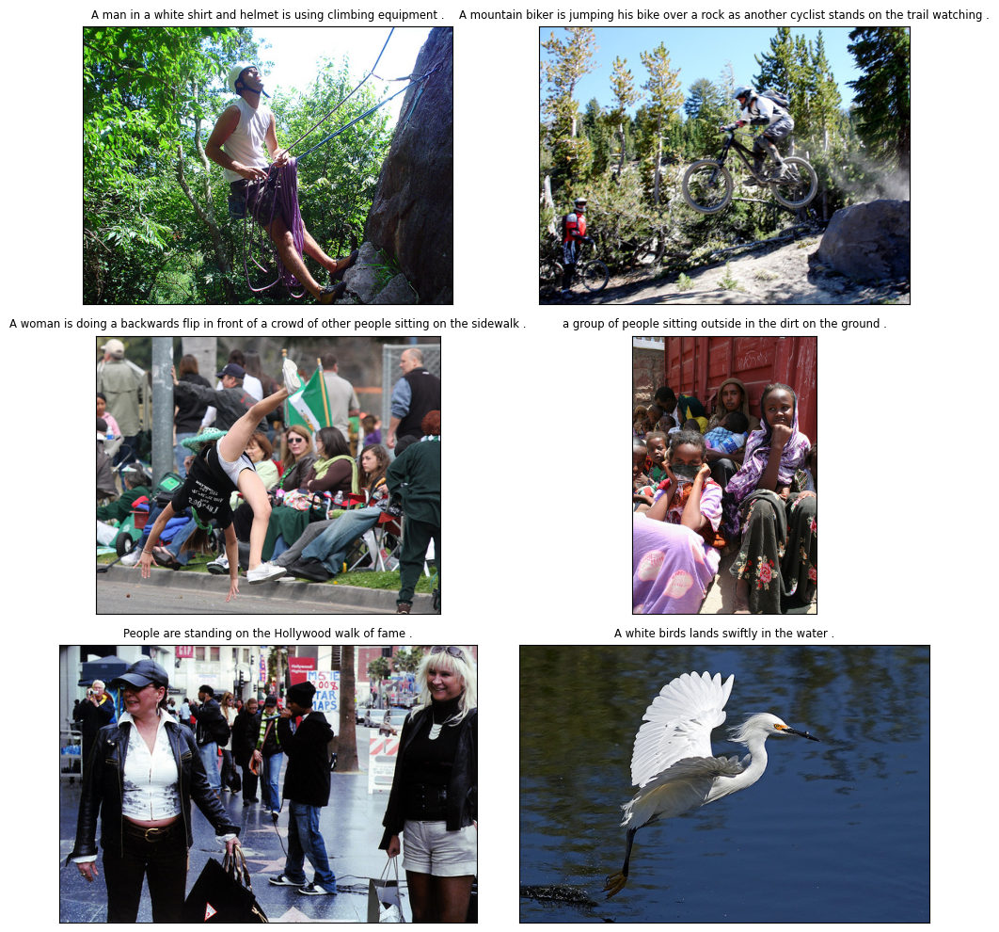

In [ ]:
# 12
selected_pairs = crowd_marks.loc[
    (crowd_marks['crowd_marks'] == '12') &
    (crowd_marks['image_is_in_query_id'] == 1),
    ['query_id', 'image'],
]
show_sample(selected_pairs)

Как видим, изображение точно соответствует описанию, а участники, которые единогласно подтвердили несоответствие, ошиблись. Чтоб низкая оценка не привела к ошибками при обучении модели, данные пары изображение-описание удалим из обучающей выборки.

In [ ]:
# Добавим пары для удаления в pairs_to_delete
pairs_to_delete = selected_pairs.copy()
pairs_to_delete.shape[0]

19

Для случаев, когда в паре изображение и "чужое" описание, в большинстве случаев участники подтверждали несоответствие, однако имеется значительное количество пар, когда участники уверенно подтверждали соответствие: 50, 42, 41, 40, 30, 31.

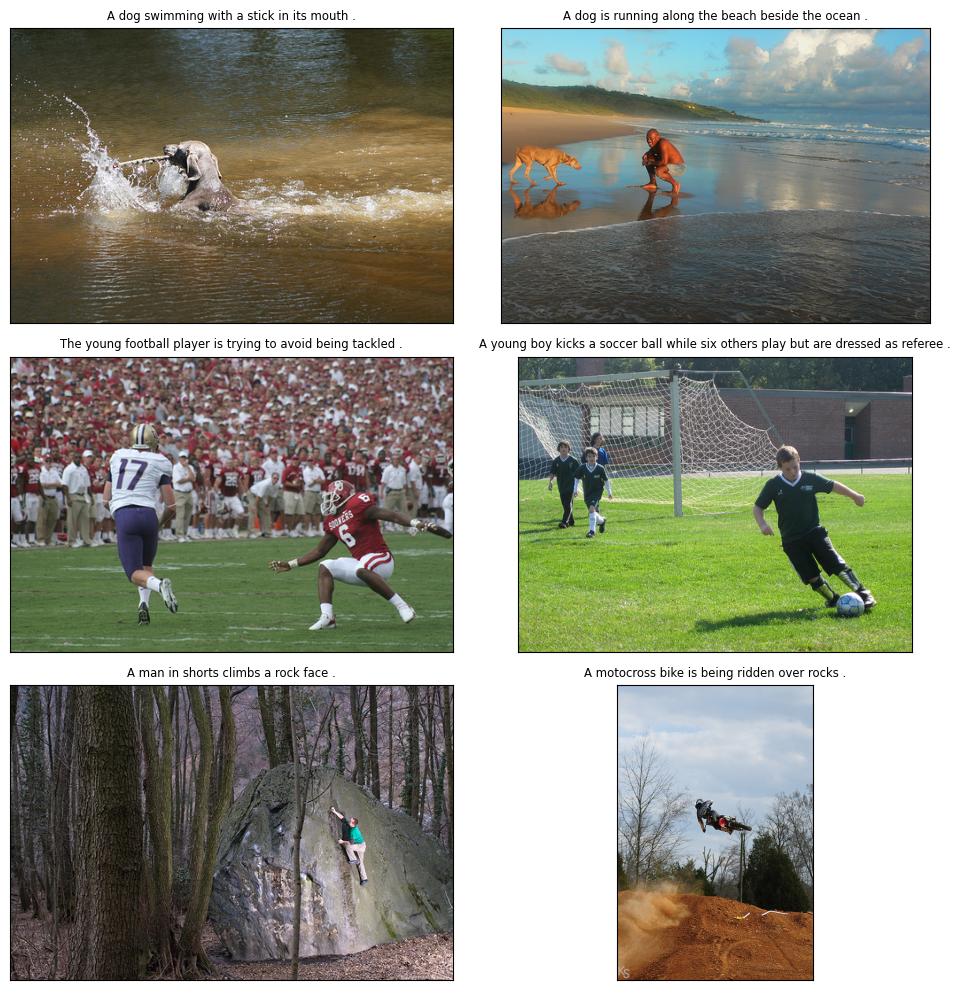

In [ ]:
# 50, 42, 41, 40, 30, 31, 21
selected_pairs = crowd_marks.loc[
    (
        (crowd_marks['crowd_marks'] == '50')
        | (crowd_marks['crowd_marks'] == '42')
        | (crowd_marks['crowd_marks'] == '41')
        | (crowd_marks['crowd_marks'] == '40')
        | (crowd_marks['crowd_marks'] == '30')
        | (crowd_marks['crowd_marks'] == '31')
        | (crowd_marks['crowd_marks'] == '21')
    )
    & (crowd_marks['image_is_in_query_id'] == 0),
    ['query_id', 'image'],
]
show_sample(selected_pairs)

Участники правильно подтвердили соответствие. Также имеются пары, для которых мнение участников не такое однозначное, со следующими комбинациями: 22, 33, 23, 32.

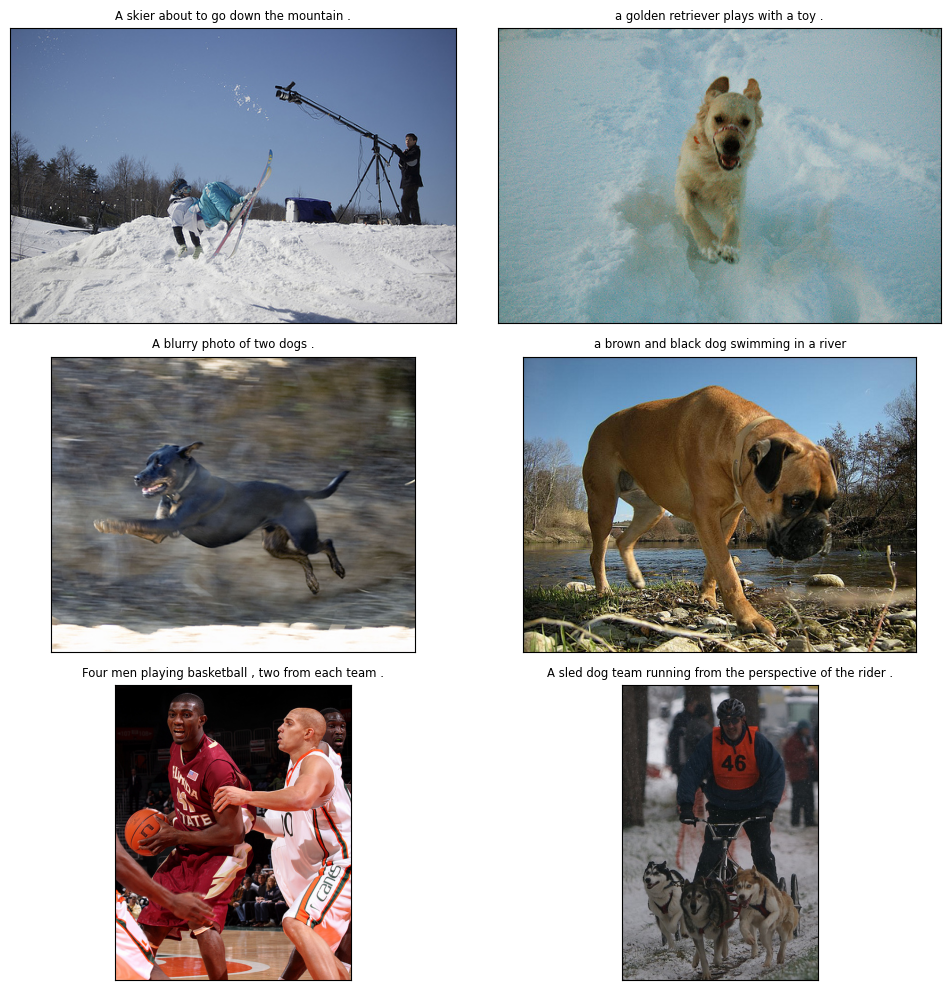

In [ ]:
# 22, 33, 23, 32
selected_pairs = crowd_marks.loc[
    (
        (crowd_marks['crowd_marks'] == '22')
        | (crowd_marks['crowd_marks'] == '33')
        | (crowd_marks['crowd_marks'] == '23')
        | (crowd_marks['crowd_marks'] == '32')
    )
    & (crowd_marks['image_is_in_query_id'] == 0),
    ['query_id', 'image'],
]
show_sample(selected_pairs)

Видим, что частичное соответвтие описанию хотя бы по типу предмета в кадре имеется, хотя и есть несоответствие по количеству предметов, например, или по смыслу происходящего в кадре. Удалим такие неоднозначные пары из набора.

In [ ]:
# Добавим пары для удаления в pairs_to_delete
pairs_to_delete = pd.concat([pairs_to_delete, selected_pairs])
pairs_to_delete.shape[0]

61

Рассмотрим примеры оставшихся пар, для которых большинство участников уверенно подтвердило несоответствие.

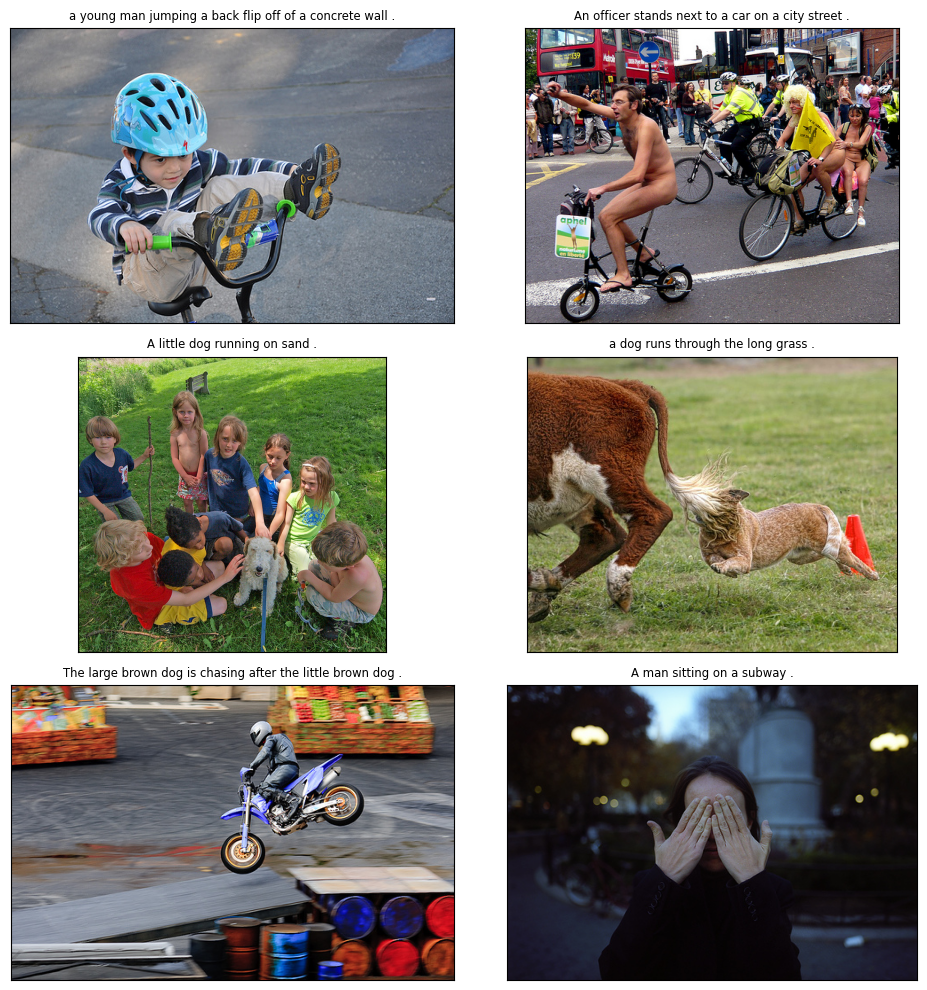

In [ ]:
# 06, 05, 04, 03, 15, 14, 13, 24, 12
selected_pairs = crowd_marks.loc[
    (
        (crowd_marks['crowd_marks'] == '06')
        | (crowd_marks['crowd_marks'] == '05')
        | (crowd_marks['crowd_marks'] == '04')
        | (crowd_marks['crowd_marks'] == '03')
        | (crowd_marks['crowd_marks'] == '15')
        | (crowd_marks['crowd_marks'] == '14')
        | (crowd_marks['crowd_marks'] == '13')
        | (crowd_marks['crowd_marks'] == '24')
        | (crowd_marks['crowd_marks'] == '12')
    )
    & (crowd_marks['image_is_in_query_id'] == 0),
    ['query_id', 'image'],
]
show_sample(selected_pairs)

Участники верно подтвердили несоответствие. Удалим пары изображение-описание, которые ранее добавили в список на удаление.

In [ ]:
pairs_to_delete = pairs_to_delete['image'] + pairs_to_delete['query_id']
print(f'К удалению {pairs_to_delete.shape[0]} пар')
print('train_df')
was = train_df.shape[0]
print(f'Строк до удаления {was}')
train_df = train_df[
    ~((train_df['image'] + train_df['query_id']).isin(pairs_to_delete))
].copy()
print(f'Строк после удаления {train_df.shape[0]}, удалено {was - train_df.shape[0]}')
print()
print('expert_marks')
was = expert_marks.shape[0]
print(f'Строк до удаления {was}')
expert_marks = expert_marks[
    ~((expert_marks['image'] + expert_marks['query_id']).isin(pairs_to_delete))
].copy()
print(
    f'Строк после удаления {expert_marks.shape[0]}, удалено {was - expert_marks.shape[0]}'
)
print()
print('crowd_marks')
was = crowd_marks.shape[0]
print(f'Строк до удаления {was}')
crowd_marks = crowd_marks[
    ~((crowd_marks['image'] + crowd_marks['query_id']).isin(pairs_to_delete))
].copy()
print(
    f'Строк после удаления {crowd_marks.shape[0]}, удалено {was - crowd_marks.shape[0]}'
)

К удалению 61 пар
train_df
Строк до удаления 5818
Строк после удаления 5809, удалено 9

expert_marks
Строк до удаления 5818
Строк после удаления 5809, удалено 9

crowd_marks
Строк до удаления 46720
Строк после удаления 46659, удалено 61


In [ ]:
crowd_marks['crowd_marks'].value_counts()

crowd_marks
03    40101
12     2941
21     1346
30     1291
04      626
05      163
13       94
06       42
14       22
31        9
40        8
50        5
41        4
15        3
42        2
24        2
Name: count, dtype: int64

In [ ]:
# Преобразуем комбинации оценок краудсорсинга в величину, которая
# отражает уверенность участников в соответствии
map = {
    '06': 0,
    '05': 0,
    '04': 0,
    '03': 0,
    '15': 0,
    '14': 0,
    '13': 0,
    '24': 0,
    '12': 1,
    '21': 2,
    '42': 3,
    '31': 3,
    '41': 3,
    '30': 3,
    '40': 3,
    '50': 3,
}
crowd_marks['crowd_marks'] = crowd_marks['crowd_marks'].replace(map)
crowd_marks['crowd_marks'].value_counts()

crowd_marks
0    41053
1     2941
2     1346
3     1319
Name: count, dtype: int64

#### Комбинация оценок экспертов и краудсорсинга

In [ ]:
# Проверим сколько пар изображение-описание совпадают в таблице краудсорсинга
# и в таблице с оценками экспертов
print(
    f'Совпадающих пар изображение-описание в таблице краудсорсинга и в таблице с оценками экспертов: \
{len(set(crowd_marks["image"]+crowd_marks["query_id"]) & set(train_df["image"]+train_df["query_id"]))}'
)

Совпадающих пар изображение-описание в таблице краудсорсинга и в таблице с оценками экспертов: 2319


In [ ]:
# Соберём в один датафрейм оценки для одинаковых пар изображение-описание
marks_df = expert_marks.merge(
    crowd_marks,
    how='inner',
    left_on=['image', 'query_id'],
    right_on=['image', 'query_id'],
    validate='1:1',
)
marks_df.head()

,image,query_id,exp_1,exp_2,exp_3,expert_marks,agree_rel,agree_cnt,disagree_cnt,image_is_in_query_id,query_text,crowd_marks
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1,1,1,0,0.000000,0,3,0.0,A young child is wearing blue goggles and sitt...,0
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2,1,0.000000,0,3,0.0,A girl wearing a yellow shirt and sunglasses s...,0
2,1056338697_4f7d7ce270.jpg,434792818_56375e203f.jpg#2,1,1,2,1,0.000000,0,3,0.0,A man and woman look back at the camera while ...,0
3,1082379191_ec1e53f996.jpg,1536774449_e16b1b6382.jpg#2,1,2,3,3,0.000000,0,3,0.0,A crowd of people at an outdoor event,0
4,1084040636_97d9633581.jpg,256085101_2c2617c5d0.jpg#2,2,3,3,5,0.333333,1,2,0.0,Close-up of dog in profile with mouth open .,1


In [ ]:
# Построим сводную таблицу
marks_pivot = (
    marks_df.pivot_table(
        index=['expert_marks'],
        columns=['crowd_marks'],
        values=['query_id'],
        aggfunc=['count'],
    )
    .fillna(0)
    .astype('int')
)
marks_pivot

count             
             query_id             
crowd_marks         0   1   2    3
expert_marks                      
0                 320   2   0    0
1                 280   2   0    0
2                 279  13   1    0
3                 389  38   4    0
4                 179  36  14    1
5                  97  52  19    3
6                  89  74  39   19
7                   9  31  36   50
8                   0   5  44  194

In [ ]:
# Преобразуем комбинации оценок в целевую переменную, которая
# отражает уверенность в соответствии
replace_map = {
    '00': 0,
    '10': 0.1,
    '01': 0.1,
    '20': 0.2,
    '11': 0.2,
    '30': 0.3,
    '21': 0.3,
    '40': 0.4,
    '31': 0.4,
    '22': 0.4,
    '50': 0.4,
    '60': 0.5,
    '41': 0.5,
    '32': 0.5,
    '70': 0.6,
    '61': 0.6,
    '51': 0.6,
    '42': 0.6,
    '43': 0.6,
    '71': 0.7,
    '52': 0.7,
    '53': 0.7,
    '81': 0.8,
    '62': 0.8,
    '63': 0.8,
    '82': 0.9,
    '72': 0.9,
    '73': 0.9,
    '83': 1,
}
marks_df['comb_marks'] = (
    marks_df['expert_marks'].astype('str') + marks_df['crowd_marks'].astype('str')
).replace(replace_map)
marks_df['comb_marks'].value_counts()

comb_marks
0.3    402
0.0    320
0.4    315
0.1    282
0.2    281
1.0    194
0.6    150
0.9    130
0.5    129
0.8     63
0.7     53
Name: count, dtype: int64

In [ ]:
# Построим сводную таблицу с целевой переменной
marks_pivot = marks_df.pivot_table(index=['expert_marks'], columns=['crowd_marks'],
                                   values=['comb_marks'], aggfunc=['mean']).fillna(0)
marks_pivot = round(marks_pivot, 2)
marks_pivot

mean               
             comb_marks               
crowd_marks           0    1    2    3
expert_marks                          
0                   0.0  0.1  0.0  0.0
1                   0.1  0.2  0.0  0.0
2                   0.2  0.3  0.4  0.0
3                   0.3  0.4  0.5  0.0
4                   0.4  0.5  0.6  0.6
5                   0.4  0.6  0.7  0.7
6                   0.5  0.6  0.8  0.8
7                   0.6  0.7  0.9  0.9
8                   0.0  0.8  0.9  1.0

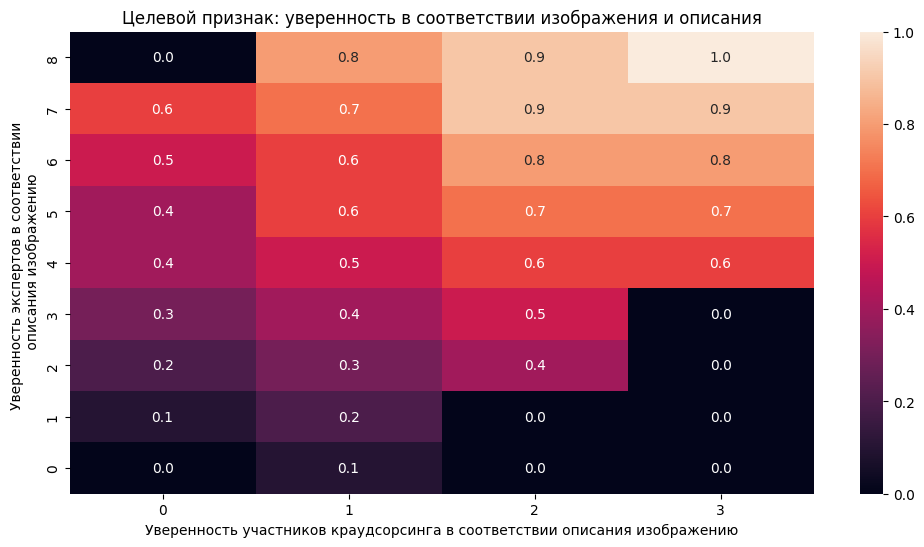

In [ ]:
# Построим тепловую карту
plt.figure(figsize=(12, 6))  # задаём размер

# строим тепловую карту
plt.title('Целевой признак: уверенность в соответствии изображения и описания')
sns.heatmap(
    marks_pivot.values[
        ::-1
    ],  # чтоб снизу были более низкие оценки, изменим порядок строк
    xticklabels=[x[2] for x in marks_pivot.columns],
    yticklabels=list(
        marks_pivot.index[::-1]
    ),  # чтоб снизу были более низкие оценки, изменим порядок строк
    annot=True,  # добавляем подписи
    ax=plt.gca(),
    fmt='',
)  # задаём исходный формат
plt.xlabel('Уверенность участников краудсорсинга в соответствии описания изображению')
plt.ylabel('Уверенность экспертов в соответствии \n описания изображению')
plt.show()

Видно, что чем выше уверенность экспертов, тем выше и уверенность участников краудсорсинга. Определим комбинации оценки экспертов и участников краудсорсинга для определения целевой переменной.

In [ ]:
# Полученное значение целевой переменной перенесём в таблицу с экспертной оценкой.
expert_marks = expert_marks.merge(
    marks_df[['image', 'query_id', 'comb_marks']],
    how='left',
    left_on=['image', 'query_id'],
    right_on=['image', 'query_id'],
    validate='1:1',
)
expert_marks.head()

,image,query_id,exp_1,exp_2,exp_3,expert_marks,comb_marks
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1,1,1,0,0.0
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2,1,0.1
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1,1,2,1,NaN
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1,2,2,2,NaN
4,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1,1,2,1,NaN


In [ ]:
# Для пар изображение-описание, у которых нет результатов краудсорсинга,
# значение целевой переменной определим через значения expert_marks
# в диапазон [0,1]
expert_marks['comb_marks'] = expert_marks['comb_marks'].fillna(
    round(expert_marks['expert_marks'] / 8, 1)
)
expert_marks['comb_marks'].value_counts()

comb_marks
0.0    2348
0.1     977
0.2     665
0.4     561
0.3     402
0.5     205
1.0     196
0.6     185
0.9     138
0.8      79
0.7      53
Name: count, dtype: int64

In [ ]:
# Полученное значение целевой переменной перенесём в таблицу с данными для обучения
train_df = train_df.merge(
    expert_marks[['image', 'query_id', 'comb_marks']],
    how='inner',
    left_on=['image', 'query_id'],
    right_on=['image', 'query_id'],
    validate='1:1',
)
train_df.head()

,image,query_id,query_text,comb_marks
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.2
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,1.0
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0


In [ ]:
# Полученное значение целевой переменной перенесём в таблицу с крудсорсинговой оценкой.
crowd_marks = crowd_marks.merge(
    marks_df[['image', 'query_id', 'comb_marks']],
    how='left',
    left_on=['image', 'query_id'],
    right_on=['image', 'query_id'],
    validate='1:1',
)
# уберём строки, по которым значение целевой переменной ранее было определено и
# для пар изображение-описание, у которых нет результатов экспертной оценки,
# значение целевой переменной определим пересчётом значения crowd_marks
# в диапазон [0,1]
print(f'Строк до удаления: {crowd_marks.shape[0]}')
print(f'Удаляем {crowd_marks[~crowd_marks["comb_marks"].isna()].shape[0]} строк')
crowd_marks = crowd_marks[crowd_marks['comb_marks'].isna()].copy()
print(f'Строк после удаления: {crowd_marks.shape[0]}')
crowd_marks['comb_marks'] = crowd_marks['crowd_marks'].apply(
    lambda x: 0 if x == 0 else 0.25 * x + 0.25, 1
)
crowd_marks['comb_marks'].value_counts(dropna=False)

Строк до удаления: 46659
Удаляем 2319 строк
Строк после удаления: 44340


comb_marks
0.00    39411
0.50     2688
0.75     1189
1.00     1052
Name: count, dtype: int64

In [ ]:
# Дополним таблицу с данными для обучения таблицей с результатами краудсорсинга
train_df = pd.concat(
    [train_df, crowd_marks[['image', 'query_id', 'query_text', 'comb_marks']]]
)
train_df.head()

,image,query_id,query_text,comb_marks
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.2
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,1.0
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0


In [ ]:
# Освободим оперативную память
del expert_marks, marks_df, crowd_marks, marks_pivot, pairs_to_delete, selected_pairs, replace_map
gc.collect()

79388

In [ ]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 50149 entries, 0 to 46658
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       50149 non-null  object 
 1   query_id    50149 non-null  object 
 2   query_text  50149 non-null  object 
 3   comb_marks  50149 non-null  float64
dtypes: float64(1), object(3)
memory usage: 1.9+ MB


Выводы исследовательскому анализу данных:
- определён состав имеющихся данных,
- проанализированы оценки экспертов и результаты краудсорсинга,
- удалены пары изображение-описание с ошибочными или противоречивыми оценками,
- на основе оценок экспертов и результатах краудсорсинга определена целевая переменная со значениями в диапазоне [0, 1].

## Проверка данных
Удалим все изображения, которые нарушают закон об ограничениях использования контента с детьми, из обучающей выборки. Создадим список слов, которые могут попадать под юридические ограничения.

In [ ]:
# Слова, по которым будем определять запрещённые изображения
words_for_ban = [
    'child',
    'children',
    'kid',
    'kids',
    'boy',
    'boys',
    'girl',
    'girls',
    'youth',
    'youths',
]

In [ ]:
# Определим функцию, которая возвращает 1 при наличии запрещённых слов в тексте
# и 0, если запрещённые слова не встречаются
def is_forbidden(text):
    # Приведём все символы к нижнему регистру
    text = text.lower()

    # Проверим на содержание запрещённых слов
    text = text.split()
    i = 0
    while words_for_ban[i] not in text and i < len(words_for_ban) - 1:
        i += 1
    if (0 <= i < len(words_for_ban) - 1) or (words_for_ban[i] in text):
        return 1
    else:
        return 0

In [ ]:
# Обозначим строки, в которых содержатся описания с запрещёнными словами
train_df['is_forbidden'] = train_df['query_text'].apply(is_forbidden)
train_df['is_forbidden'].value_counts()

is_forbidden
0    36391
1    13758
Name: count, dtype: int64

In [ ]:
# Определим запрещённые изображения
images_for_ban = list(
    train_df[
        (train_df['is_forbidden'] == 1)
        & (train_df['query_id'].str[:-2] == train_df['image'])
    ]['image']
)
print(f'Изображений, на которых по описанию присутствуют дети: {len(images_for_ban)}')
# Удалим строки, в которых содержатся пары с запрещёнными изображениями
print(f'До удаления {train_df.shape[0]} строк')
print(f'Удаляем {train_df[train_df["image"].isin(images_for_ban)].shape[0]} строк')
train_df = train_df[~train_df["image"].isin(images_for_ban)]
print(f'Осталось после удаления {train_df.shape[0]} строк')

Изображений, на которых по описанию присутствуют дети: 188
До удаления 50149 строк
Удаляем 9872 строк
Осталось после удаления 40277 строк


## Векторизация изображений

Для векторизации изображений возьмём за основу предварительно обученную на датасете ImageNet модель ResNet-50, посмотрим на слои и исключим полносвязные слои, которые отвечают за конечное предсказание.

In [ ]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda', index=0)

In [ ]:
# Загрузим модель ResNet-50
resnet = models.resnet50(weights=ResNet50_Weights.DEFAULT).to(device) #загружаем претренированную модель

In [ ]:
# Обучать модель не потребуется, поэтому заморозим веса
for param in resnet.parameters():
    param.requires_grad_(False)

In [ ]:
# Посмотрим список слоёв
print(list(resnet.children()))

[Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False), BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True), ReLU(inplace=True), MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False), Sequential(
  (0): Bottleneck(
    (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (downsample): Sequential(
      (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=Tr

In [ ]:
# Оставим только свёрточные слои и AdaptiveAvgPool2d (все, кроме последнего)
modules = list(resnet.children())[:-1]
resnet = nn.Sequential(*modules)

In [ ]:
# Переведём модель в режим предсказания
resnet.eval()

Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)


In [ ]:
# Изображение перед векторизацией необходимо привести в определённый формат:
# изменить размер картинки, вырезать центр и нормализовать
norm = transforms.Normalize(
    mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    norm
])

In [ ]:
# Создадим список уникальных изображений, чтоб векторизовать одно изображение один раз
train_images = pd.DataFrame(train_df['image'].unique(), columns=['image'])
print(f'Изображений для векторизации {train_images.shape[0]}')

Изображений для векторизации 812


In [ ]:
# Получим тензор для первого изображения
img = Image.open('train_images/' + train_images['image'][0]).convert('RGB')
# так как у нас одно изображение, то четвёртое измерение (размер батча) не задаётся
img_tensor = preprocess(img).unsqueeze(0).to(device)  # а пишется .unsqueeze(0)
img_tensor = resnet(img_tensor).flatten()  # спрямим тензор в вектор
train_images_tensor = img_tensor.reshape(1, img_tensor.shape[0])

Для наглядного контроля прогресса подключим библиотеку tqdm (араб. taqadum, تقدّم, «прогресс») и в jupyter применим функцию notebook() из этой библиотеки.

In [ ]:
# Аналогично получим эмбеддинги остальных изображений
for i in notebook.tqdm(range(1, train_images.shape[0])):
    image_file = train_images['image'][i]
    img = Image.open('train_images/' + image_file).convert('RGB')
    img_tensor = preprocess(img).unsqueeze(0).to(device)
    img_tensor = resnet(img_tensor).flatten()
    train_images_tensor = torch.cat(
        (train_images_tensor, img_tensor.reshape(1, img_tensor.shape[0])), 0
    )
train_images_tensor.shape

  0%|          | 0/811 [00:00<?, ?it/s]

torch.Size([812, 2048])

Аналогичную векторизацию выполним для тестовых изображений

In [ ]:
print(f'Изображений для векторизации {test_images.shape[0]}')
# Первое изображение
img = Image.open('test_images/' + test_images['image'][0]).convert('RGB')
img_tensor = preprocess(img).unsqueeze(0).to(device)  # а пишется .unsqueeze(0)
img_tensor = resnet(img_tensor).flatten()  # спрямим тензор в вектор
test_images_tensor = img_tensor.reshape(1, img_tensor.shape[0])

Изображений для векторизации 100


In [ ]:
# Аналогично получим эмбеддинги остальных изображений
for i in notebook.tqdm(range(1, test_images.shape[0])):
    image_file = test_images['image'][i]
    img = Image.open('test_images/' + image_file).convert('RGB')
    img_tensor = preprocess(img).unsqueeze(0).to(device)
    img_tensor = resnet(img_tensor).flatten()
    test_images_tensor = torch.cat(
        (test_images_tensor, img_tensor.reshape(1, img_tensor.shape[0])), 0
    )
test_images_tensor.shape

  0%|          | 0/99 [00:00<?, ?it/s]

torch.Size([100, 2048])

In [ ]:
# Освободим память
del image_file, img_tensor, preprocess, norm, resnet, modules, param
gc.collect()

27

## Векторизация текстов

Прежде чем перевести тексты в векторы, подготовим их. У BERT есть собственный токенизатор. Это инструмент, который разбивает и преобразует исходные тексты в список токенов, которые есть в словаре. Лемматизация не требуется.  
Для работы возьмём предобученную модель с ресурса https://docs.deeppavlov.ai/en/master/features/models/bert.html  
Сама модель взята по адресу: http://files.deeppavlov.ai/deeppavlov_data/bert/conversational_cased_L-12_H-768_A-12_pt_v1.tar.gz

Будем использовать:
- модель (файл pytorch_model.bin),
- файл конфигурации модели (config.json),
- словарь для токенизации (файл vocab.txt).

In [ ]:
# Создадим список уникальных текстов, чтоб векторизовать один текст один раз
train_queries = pd.DataFrame(train_df['query_text'].unique(), columns=['query_text'])
print(f'Текстов для векторизации {train_queries.shape[0]}')

Текстов для векторизации 977


In [ ]:
# Инициализируем токенизатор как объект класса BertTokenizer().
# Передадим ему аргумент vocab_file — это файл со словарём, на котором обучалась модель.
# Он может быть, например, в текстовом формате (txt)
tokenizer = transformers.BertTokenizer(
    do_lower_case=True,
    vocab_file='conversational_cased_L-12_H-768_A-12_pt_v1/vocab.txt',
)

# Для контроля прогресса будем использовать progress_apply
tqdm.pandas()

# Преобразуем текст в номера токенов из словаря методом encode()
# Для корректной работы модели мы указали аргумент add_special_tokens (англ. «добавить специальные токены»),
# равный True. Это значит, что к любому преобразуемому тексту добавляется токен начала (101) и токен конца текста (102).
# Для уменьшения количества токенов применим truncation
tokenized = train_queries['query_text'].progress_apply(
    lambda x: tokenizer.encode(
        x, add_special_tokens=True, max_length=512, truncation='longest_first'
    )
)

# Применим метод padding (англ. «отступ»), чтобы после токенизации длины исходных текстов в корпусе были равными.
# Только при таком условии будет работать модель BERT. Пусть стандартной длиной вектора n будет длина наибольшего
# во всём датасете вектора. Остальные векторы дополним нулями
max_len = 0
for i in tokenized.values:
    if len(i) > max_len:
        max_len = len(i)

padded = np.array([i + [0] * (max_len - len(i)) for i in tokenized.values])

# Теперь поясним модели, что нули не несут значимой информации. Это нужно для компоненты модели,
# которая называется «внимание» (англ. attention). Отбросим эти токены и «создадим маску» для действительно
# важных токенов, то есть укажем нулевые и не нулевые значения:
attention_mask = np.where(padded != 0, 1, 0)


100%|██████████████████████████████████████████████████████████████████████████████| 977/977 [00:00<00:00, 4189.30it/s]


In [ ]:
padded.shape

(977, 38)

In [ ]:
attention_mask.shape

(977, 38)

In [ ]:
# Инициализируем саму модель класса BertModel.
# Передадим ей файл с предобученной моделью и конфигурацией:
config = transformers.BertConfig.from_json_file(
    'conversational_cased_L-12_H-768_A-12_pt_v1/config.json'
)
model = transformers.BertModel.from_pretrained(
    'conversational_cased_L-12_H-768_A-12_pt_v1/pytorch_model.bin', config=config
).to(device)

In [ ]:
# Эмбеддинги моделью BERT будем создавать батчами. Чтобы хватило оперативной памяти, сделаем размер батча небольшим
batch_size = 100
embeddings = []
k = 0
# Сделаем цикл по батчам. Отображать прогресс будет функция notebook()
for i in notebook.tqdm(range(round(np.ceil(padded.shape[0] / batch_size)))):
    # Преобразуем данные в формат тензоров (англ. tensor) — многомерных векторов в библиотеке torch.
    # Тип данных LongTensor (англ. «длинный тензор») хранит числа в «длинном формате», то есть выделяет
    # на каждое число 64 бита.
    # Преобразуем данные
    batch = torch.LongTensor(padded[batch_size * i : batch_size * (i + 1)]).to(device)
    # Преобразуем маску
    attention_mask_batch = torch.LongTensor(
        attention_mask[batch_size * i : batch_size * (i + 1)]
    ).to(device)
    # Чтобы получить эмбеддинги для батча, передадим модели данные и маску
    # Для ускорения вычисления функцией no_grad() (англ. no gradient, «нет градиента») в
    # библиотеке torch укажем, что градиенты не нужны: модель BERT обучать не будем.
    with torch.no_grad():
        batch_embeddings = model(batch, attention_mask=attention_mask_batch)
    # Из полученного тензора извлечём нужные элементы (для каждого текста выберем эмбеддинг первого токена,
    # соответствующего началу текста) и добавим в список всех эмбеддингов
    # преобразуем элементы методом numpy() к типу numpy.array
    embeddings.append(batch_embeddings[0][:, 0, :].cpu().numpy())
train_queries_embeddings = pd.DataFrame(
    np.concatenate(embeddings),
    columns=['q_emb_' + str(x) for x in range(np.concatenate(embeddings).shape[1])],
)

  0%|          | 0/10 [00:00<?, ?it/s]

In [ ]:
train_queries_embeddings.shape

(977, 768)

In [ ]:
# освободим оперативную память
del tokenized, embeddings, batch_size, batch
gc.collect()

75

## Объединение векторов

Подготовим данные для обучения: объединим векторы изображений и векторы текстов с целевой переменной.

In [ ]:
# Дополним таблицу с именем файла изображения эмбеддингами
train_images = pd.concat(
    [
        train_images,
        pd.DataFrame(
            train_images_tensor.cpu(),
            columns=[
                'im_emb_' + str(x) for x in range(0, train_images_tensor.shape[1])
            ]
        )
    ],
    axis=1
)
display(train_images.head(3))
train_images.shape

,image,im_emb_0,im_emb_1,im_emb_2,im_emb_3,im_emb_4,im_emb_5,im_emb_6,im_emb_7,im_emb_8,...,im_emb_2038,im_emb_2039,im_emb_2040,im_emb_2041,im_emb_2042,im_emb_2043,im_emb_2044,im_emb_2045,im_emb_2046,im_emb_2047
0,1056338697_4f7d7ce270.jpg,0.688016,0.014028,0.056768,1.957673,0.086148,0.098758,0.000000,1.182842,0.0,...,0.000000,0.000000,0.000000,0.023563,0.319303,0.029336,0.254765,0.128608,0.060605,0.000000
1,1262583859_653f1469a9.jpg,0.163761,0.000000,0.000000,0.012330,0.000181,0.056436,0.000000,1.174411,0.0,...,0.204273,0.103885,0.000000,0.000000,0.000000,0.000000,0.077420,0.818168,0.601508,0.097681
2,2621415349_ef1a7e73be.jpg,0.000000,0.000367,0.007885,0.000000,0.000000,0.000000,0.244881,0.128507,0.0,...,0.000000,0.039779,0.003692,0.398477,0.000000,0.021816,0.574448,0.020297,0.083758,0.476585


(812, 2049)

In [ ]:
# То же проделаем и с тестовой выборкой изображений
test_images = pd.concat(
    [
        test_images,
        pd.DataFrame(
            test_images_tensor.cpu(),
            columns=['im_emb_' + str(x) for x in range(0, test_images_tensor.shape[1])]
        )
    ],
    axis=1,
)
display(test_images.head(3))
test_images.shape

,image,im_emb_0,im_emb_1,im_emb_2,im_emb_3,im_emb_4,im_emb_5,im_emb_6,im_emb_7,im_emb_8,...,im_emb_2038,im_emb_2039,im_emb_2040,im_emb_2041,im_emb_2042,im_emb_2043,im_emb_2044,im_emb_2045,im_emb_2046,im_emb_2047
0,3356748019_2251399314.jpg,0.000000,0.0,0.000000,0.028573,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.000000,0.000000,0.000000,0.0,0.00000,0.000000,0.047273,0.000000,0.029864
1,2887171449_f54a2b9f39.jpg,0.004097,0.0,0.017984,0.396661,0.228592,0.564577,1.560788,1.912057,0.094883,...,0.0,0.229376,0.305812,0.081887,0.0,0.07618,0.476076,0.162654,0.000000,0.000000
2,3089107423_81a24eaf18.jpg,0.002944,0.0,0.003869,0.005144,0.000000,0.000000,0.012929,0.236036,0.023146,...,0.0,0.234423,0.124886,0.000000,0.0,0.01020,0.043005,0.632190,0.013783,0.187701


(100, 2049)

In [ ]:
# Дополним таблицу с текстами описаний эмбеддингами
train_queries = pd.concat([train_queries, train_queries_embeddings], axis=1)
display(train_queries.head(3))
train_queries.shape

,query_text,q_emb_0,q_emb_1,q_emb_2,q_emb_3,q_emb_4,q_emb_5,q_emb_6,q_emb_7,q_emb_8,...,q_emb_758,q_emb_759,q_emb_760,q_emb_761,q_emb_762,q_emb_763,q_emb_764,q_emb_765,q_emb_766,q_emb_767
0,A young child is wearing blue goggles and sitt...,-0.112728,0.184086,-0.355635,-0.086908,-0.187891,-0.557274,0.081059,-0.500921,-0.026967,...,0.433788,0.681948,-0.112041,0.055559,-0.138844,0.116399,-0.448431,-0.293059,0.267916,0.242086
1,A girl wearing a yellow shirt and sunglasses s...,-0.430264,0.120236,-0.065590,0.022804,-0.400981,-0.025846,0.346401,-0.425973,-0.048584,...,0.537449,0.383387,-0.060295,0.191479,0.043277,-0.261442,-0.226042,-0.298826,0.403957,0.260924
2,A man sleeps under a blanket on a city street .,-0.126450,0.149364,-0.273919,-0.224815,-0.306190,-0.328223,0.157549,-0.656130,-0.138693,...,0.494816,0.295321,-0.240454,0.297992,-0.180813,-0.188345,-0.486577,-0.231171,0.431210,0.258704


(977, 769)

In [ ]:
# Добавим в датафрейм для обучения векторы текстов
train_df = train_df.merge(
    train_queries,
    how='left',
    left_on=['query_text'],
    right_on=['query_text'],
    validate='m:1'
)
train_df.shape

(40277, 773)

In [ ]:
# Добавим в датафрейм для обучения векторы изображений
train_df = train_df.merge(
    train_images, how='left', left_on=['image'], right_on=['image'], validate='m:1'
)
train_df.shape

(40277, 2821)

In [ ]:
# Удалим лишние столбцы
train_df = train_df.drop(['is_forbidden'], axis=1)
train_df.shape

(40277, 2820)

Выводы:
- с помощью модели BERT получены векторы текстов размером 768,
- с помощью модели ResNet50 получены веторы изображений размером 2048,
- для пар описание-изображение получены объединённые векторы размером 768+2048=2816.

## Обучение моделей

Для обучения разделим датасет на тренировочную и валидационную выборки. Простое случайное разбиение не подходит: необходимо исключить попадание изображения и в обучающую, и в тестовую выборки.
Для того, чтобы учесть изображения при разбиении, воспользуемся классом GroupShuffleSplit из библиотеки sklearn.model_selection.

### Подготовка данных к обучению

In [ ]:
# Сохраним датасет для обучения в файл
#pd.DataFrame(train_df).to_csv(f'train_df.csv')

Откроем датасет
train_df = pd.read_csv('train_df.csv', index_col=0)

In [ ]:
# Разобъём датасет на тренировочную и валидационную выборки в пропорции 8:2 так,
# что строки с одинаковым значением 'image' будут содержаться либо в тестовом, либо в тренировочном датасете.
gss = GroupShuffleSplit(n_splits=1, train_size=0.8, random_state=RANDOM_STATE)
train_indices, valid_indices = next(
    gss.split(
        X=train_df.drop(columns=['comb_marks']),
        y=train_df['comb_marks'],
        groups=train_df['image'],
    )
)
train, valid = train_df.loc[train_indices], train_df.loc[valid_indices]
print(f'Обучающая выборка: {train.shape}')
print(f'Валидационная выборка: {valid.shape}')

Обучающая выборка: (31941, 2820)
Валидационная выборка: (8336, 2820)


In [ ]:
# Выделим датасет с признаками-векторами
X_train = (
    train.drop(['image', 'query_id', 'query_text', 'comb_marks'], axis=1).copy().values
)
print(X_train.shape)
X_val = (
    valid.drop(['image', 'query_id', 'query_text', 'comb_marks'], axis=1).copy().values
)
X_val.shape

(31941, 2816)


(8336, 2816)

In [ ]:
# Выделим датасет с целевой переменной
y_train = train['comb_marks'].copy().values
print(y_train.shape)
y_val = valid['comb_marks'].copy().values
print(y_val.shape)

(31941,)
(8336,)


In [ ]:
# Выполним масштабирование числовых признаков
scaler = MinMaxScaler()
scaler.fit(X_train)
X_train_scaled = scaler.transform(X_train)

# C подготовленным на обучающей выборке скалером выполним масштабирование признаков тестовой выборки
X_val_scaled = scaler.transform(X_val)

### Константная модель

In [ ]:
# Создадим и обучим константную модель, которая всегда возвращает одно значение
dummy_regr = DummyRegressor(strategy='mean', constant=None, quantile=None)
dummy_regr.fit(X_train, y_train)

DummyRegressor()

In [ ]:
# Проверим качество. В качестве метрики будем использовать
# величину средней абсолютной ошибки.
mean_absolute_error(y_val, dummy_regr.predict(X_val))

0.15258549066684307

### Линейная регрессия

In [ ]:
# Перебором гиперпараметров выберем модель, проверяя качество на валидационной выборке.
# В качестве метрики будем использовать величину средней абсолютной ошибки.
best_mae = 1
best_solver = ''
best_alpha = 0
for solver in ['sag', 'saga']:
    for alpha in np.logspace(-1, 3, 10):
        # Обучим модель
        lr = Ridge(random_state=RANDOM_STATE, solver=solver, alpha=alpha)
        lr.fit(X_train, y_train)
        mae = mean_absolute_error(y_val, lr.predict(X_val))
        if mae < best_mae:
            best_mae = mae
            best_solver = solver
            best_alpha = alpha

# лучшее значение MAPE
print(f'Лучшее значение MAE: {best_mae}')
# лучшие гиперпараметры
print(f'best_params:\n solver {best_solver} \n alpha {best_alpha}')

Лучшее значение MAE: 0.14279431851273278
best_params:
 solver sag 
 alpha 1000


### Полносвязная нейронная сеть

In [ ]:
# Преобразуем данные в тензоры
X_train = torch.FloatTensor(X_train_scaled).to(device)
X_val = torch.FloatTensor(X_val_scaled).to(device)
y_train = torch.FloatTensor(y_train).flatten().to(device)
y_val = torch.FloatTensor(y_val).flatten().to(device)

В качестве базовой модели возьмём нейронную сеть с одним скрытым слоем.

Параметры сети:
- количество нейрнов во входном слое - 2816 (по числу признаков),
- количество нейронов в выходном слое - 1,
- количество нейронов в скрытом слое будем перебирать от $\sqrt{2816*1} \approx 53$ (примем 64) до $(2816+1)*(2/3)=1878$ по степеням двойки 64, 128, 256, 512, 1024, 1878,
- функция активации скрытого слоя - ReLU, выходного слоя - Sigmoid,
- инициализация весов модели - по умолчанию,
- функция потерь - mean squared error, MSE,
- метрика - mean absolute error, MAE.

In [ ]:
# Создадим класс для задания архитектуры нейронной сети
class BaseNet_1(nn.Module):
    def __init__(self, n_in_neurons, n_hidden_neurons, n_out_neurons):
        super(BaseNet_1, self).__init__()

        self.fc1 = nn.Linear(n_in_neurons, n_hidden_neurons)
        self.act1 = nn.ReLU()

        self.fc2 = nn.Linear(n_hidden_neurons, n_out_neurons)
        self.act2 = nn.Sigmoid()

    def forward(self, x):
        x = self.fc1(x)
        x = self.act1(x)

        x = self.fc2(x)
        x = self.act2(x)

        return x

In [ ]:
# Создадим функцию для обучения нейронной сети
def train_net(
    net, X_train, y_train, X_val, y_val, num_epochs, batch_size, learning_rate
):
    optimizer = torch.optim.Adam(net.parameters(), lr=learning_rate)
    loss = nn.MSELoss()
    num_batches = ceil(len(X_train) / batch_size)
    best_result = max(y_val)
    for epoch in range(num_epochs):
        order = np.random.permutation(
            len(X_train)
        )  # создадим случайную перестановку индексов объектов
        for batch_idx in range(num_batches):
            start_index = (
                batch_idx * batch_size
            )  # посчитаем номер стартового объекта батча
            optimizer.zero_grad()

            batch_indexes = order[
                start_index : start_index + batch_size
            ]  # извлечём индексы объектов текущего обатча
            X_batch = X_train[batch_indexes].to(device)
            y_batch = y_train[batch_indexes].to(device)
            preds = net.forward(X_train).flatten().to(device)
            loss_value = loss(preds, y_train)
            loss_value.backward()
            optimizer.step()
        if epoch % 1 == 0 or epoch + 1 == num_epochs:
            net.eval()
            val_preds = net.forward(X_val).flatten().to(device)
            mae = round(
                mean_absolute_error(
                    y_val.cpu().detach().numpy(), val_preds.cpu().detach().numpy()
                ),
                3
            )
            print(f'эпоха {epoch}, MAE: {mae: .3f}, best_MAE: {best_result: .3f}')
            if mae < best_result:
                best_result = mae
                best_net = net
            elif mae > 1.2 * best_result:
                best_net.eval()
                print(
                    f"Обучение закончилось с лучшим результатом (MAE): {best_result: .3f}"
                )
                return best_net
            net.train()
    best_net.eval()
    return best_net

In [ ]:
# Перебором количества нейронов в скрытом слое найдём базовую модель с лучшим значением метрики
num_epochs = 10
batch_size = 200
learning_rate = 1.0e-4
for n_hid in [64, 128, 256, 512, 1024, 1878]:
    print("Hidden neurones", n_hid)
    base_net = BaseNet_1(2816, n_hid, 1).to(device)
    base_net = train_net(
        base_net,
        X_train,
        y_train,
        X_val,
        y_val,
        num_epochs,
        batch_size,
        learning_rate,
    )
    print()

Hidden neurones 64
эпоха 0, MAE:  0.152, best_MAE:  1.000
эпоха 1, MAE:  0.152, best_MAE:  0.152
эпоха 2, MAE:  0.152, best_MAE:  0.152
эпоха 3, MAE:  0.152, best_MAE:  0.152
эпоха 4, MAE:  0.151, best_MAE:  0.152
эпоха 5, MAE:  0.150, best_MAE:  0.151
эпоха 6, MAE:  0.149, best_MAE:  0.150
эпоха 7, MAE:  0.148, best_MAE:  0.149
эпоха 8, MAE:  0.147, best_MAE:  0.148
эпоха 9, MAE:  0.146, best_MAE:  0.147

Hidden neurones 128
эпоха 0, MAE:  0.152, best_MAE:  1.000
эпоха 1, MAE:  0.152, best_MAE:  0.152
эпоха 2, MAE:  0.151, best_MAE:  0.152
эпоха 3, MAE:  0.149, best_MAE:  0.151
эпоха 4, MAE:  0.148, best_MAE:  0.149
эпоха 5, MAE:  0.146, best_MAE:  0.148
эпоха 6, MAE:  0.145, best_MAE:  0.146
эпоха 7, MAE:  0.144, best_MAE:  0.145
эпоха 8, MAE:  0.142, best_MAE:  0.144
эпоха 9, MAE:  0.141, best_MAE:  0.142

Hidden neurones 256
эпоха 0, MAE:  0.152, best_MAE:  1.000
эпоха 1, MAE:  0.151, best_MAE:  0.152
эпоха 2, MAE:  0.149, best_MAE:  0.151
эпоха 3, MAE:  0.146, best_MAE:  0.149
эпо

Лучшее значение, которое удалось добиться с базовой моделью - 0.132 (1024 нейрона в скрытом слое). Попробуем добавить ещё слой.

In [ ]:
# Создадим класс для задания архитектуры нейронной сети
class BaseNet_2(nn.Module):
    def __init__(
        self, n_in_neurons, n_hidden_neurons_1, n_hidden_neurons_2, n_out_neurons
    ):
        super(BaseNet_2, self).__init__()

        self.fc1 = nn.Linear(n_in_neurons, n_hidden_neurons_1)
        self.act1 = nn.ReLU()

        self.fc2 = nn.Linear(n_hidden_neurons_1, n_hidden_neurons_2)
        self.act2 = nn.ReLU()

        self.fc3 = nn.Linear(n_hidden_neurons_2, n_out_neurons)
        self.act3 = nn.Sigmoid()

    def forward(self, x):
        x = self.fc1(x)
        x = self.act1(x)

        x = self.fc2(x)
        x = self.act2(x)

        x = self.fc3(x)
        x = self.act3(x)

        return x

In [ ]:
# Перебором количества нейронов в скрытых слоях найдём модель с лучшим значением метрики
num_epochs = 10
batch_size = 200
learning_rate = 1.0e-4
for n_hid_1 in [64, 128, 256, 512, 1024, 1878]:
    for n_hid_2 in [64, 128, 256, 512, 1024, 1878]:
        base_net = BaseNet_2(2816, n_hid_1, n_hid_2, 1).to(device)
        print(f"Hidden neurones: n_hid_1 {n_hid_1}, n_hid_2 {n_hid_2}")
        base_net = train_net(
            base_net,
            X_train,
            y_train,
            X_val,
            y_val,
            num_epochs,
            batch_size,
            learning_rate
        )
        print('end of variant')
        print()

Hidden neurones: n_hid_1 64, n_hid_2 64
эпоха 0, MAE:  0.152, best_MAE:  1.000
эпоха 1, MAE:  0.152, best_MAE:  0.152
эпоха 2, MAE:  0.152, best_MAE:  0.152
эпоха 3, MAE:  0.152, best_MAE:  0.152
эпоха 4, MAE:  0.152, best_MAE:  0.152
эпоха 5, MAE:  0.151, best_MAE:  0.152
эпоха 6, MAE:  0.150, best_MAE:  0.151
эпоха 7, MAE:  0.148, best_MAE:  0.150
эпоха 8, MAE:  0.146, best_MAE:  0.148
эпоха 9, MAE:  0.144, best_MAE:  0.146
end of variant

Hidden neurones: n_hid_1 64, n_hid_2 128
эпоха 0, MAE:  0.151, best_MAE:  1.000
эпоха 1, MAE:  0.150, best_MAE:  0.151
эпоха 2, MAE:  0.148, best_MAE:  0.150
эпоха 3, MAE:  0.145, best_MAE:  0.148
эпоха 4, MAE:  0.142, best_MAE:  0.145
эпоха 5, MAE:  0.140, best_MAE:  0.142
эпоха 6, MAE:  0.138, best_MAE:  0.140
эпоха 7, MAE:  0.137, best_MAE:  0.138
эпоха 8, MAE:  0.136, best_MAE:  0.137
эпоха 9, MAE:  0.135, best_MAE:  0.136
end of variant

Hidden neurones: n_hid_1 64, n_hid_2 256
эпоха 0, MAE:  0.152, best_MAE:  1.000
эпоха 1, MAE:  0.152, best_

эпоха 3, MAE:  0.144, best_MAE:  0.148
эпоха 4, MAE:  0.139, best_MAE:  0.144
эпоха 5, MAE:  0.136, best_MAE:  0.139
эпоха 6, MAE:  0.133, best_MAE:  0.136
эпоха 7, MAE:  0.130, best_MAE:  0.133
эпоха 8, MAE:  0.129, best_MAE:  0.130
эпоха 9, MAE:  0.129, best_MAE:  0.129
end of variant

Hidden neurones: n_hid_1 512, n_hid_2 128
эпоха 0, MAE:  0.152, best_MAE:  1.000
эпоха 1, MAE:  0.150, best_MAE:  0.152
эпоха 2, MAE:  0.143, best_MAE:  0.150
эпоха 3, MAE:  0.138, best_MAE:  0.143
эпоха 4, MAE:  0.133, best_MAE:  0.138
эпоха 5, MAE:  0.133, best_MAE:  0.133
эпоха 6, MAE:  0.133, best_MAE:  0.133
эпоха 7, MAE:  0.130, best_MAE:  0.133
эпоха 8, MAE:  0.127, best_MAE:  0.130
эпоха 9, MAE:  0.129, best_MAE:  0.127
end of variant

Hidden neurones: n_hid_1 512, n_hid_2 256
эпоха 0, MAE:  0.152, best_MAE:  1.000
эпоха 1, MAE:  0.150, best_MAE:  0.152
эпоха 2, MAE:  0.143, best_MAE:  0.150
эпоха 3, MAE:  0.136, best_MAE:  0.143
эпоха 4, MAE:  0.134, best_MAE:  0.136
эпоха 5, MAE:  0.129, best

Удалось улучшить результат. Наилучшее достигнутое значение метрики 0,115 (в первом слое 1878 нейронов, во втором слое - 512).  Попробуем добавить batch normalization к модели с двумя слоями. Количество нейронов будем перебирать в диапазоне, который позволил получить наилучшую метрику в предыдущем эксперименте.

In [ ]:
# Создадим класс для задания архитектуры нейронной сети
class Net_batch(nn.Module):
    def __init__(
        self, n_in_neurons, n_hidden_neurons_1, n_hidden_neurons_2, n_out_neurons
    ):
        super(Net_batch, self).__init__()

        self.fc1 = nn.Linear(n_in_neurons, n_hidden_neurons_1)
        self.bn1 = nn.BatchNorm1d(n_hidden_neurons_1)
        self.act1 = nn.ReLU()

        self.fc2 = nn.Linear(n_hidden_neurons_1, n_hidden_neurons_2)
        self.act2 = nn.ReLU()

        self.fc3 = nn.Linear(n_hidden_neurons_2, n_out_neurons)
        self.act3 = nn.Sigmoid()

    def forward(self, x):
        x = self.fc1(x)
        x = self.bn1(x)
        x = self.act1(x)

        x = self.fc2(x)
        x = self.act2(x)

        x = self.fc3(x)
        x = self.act3(x)

        return x

In [ ]:
# Перебором количества нейронов в скрытом слое найдём модель с лучшим значением метрики
num_epochs = 10
batch_size = 200
learning_rate = 1.0e-4
for n_hid_1 in [512, 1024, 1878]:
    for n_hid_2 in [512, 1024, 1878]:
        base_net = Net_batch(2816, n_hid_1, n_hid_2, 1).to(device)
        print(f"Hidden neurones: n_hid_1 {n_hid_1}, n_hid_2 {n_hid_2}")
        base_net = train_net(
            base_net,
            X_train,
            y_train,
            X_val,
            y_val,
            num_epochs,
            batch_size,
            learning_rate
        )
        print('end of variant')
        print()

Hidden neurones: n_hid_1 512, n_hid_2 512
эпоха 0, MAE:  0.128, best_MAE:  1.000
эпоха 1, MAE:  0.101, best_MAE:  0.128
эпоха 2, MAE:  0.093, best_MAE:  0.101
эпоха 3, MAE:  0.091, best_MAE:  0.093
эпоха 4, MAE:  0.091, best_MAE:  0.091
эпоха 5, MAE:  0.091, best_MAE:  0.091
эпоха 6, MAE:  0.091, best_MAE:  0.091
эпоха 7, MAE:  0.090, best_MAE:  0.091
эпоха 8, MAE:  0.092, best_MAE:  0.090
эпоха 9, MAE:  0.091, best_MAE:  0.090
end of variant

Hidden neurones: n_hid_1 512, n_hid_2 1024
эпоха 0, MAE:  0.121, best_MAE:  1.000
эпоха 1, MAE:  0.095, best_MAE:  0.121
эпоха 2, MAE:  0.093, best_MAE:  0.095
эпоха 3, MAE:  0.092, best_MAE:  0.093
эпоха 4, MAE:  0.092, best_MAE:  0.092
эпоха 5, MAE:  0.091, best_MAE:  0.092
эпоха 6, MAE:  0.091, best_MAE:  0.091
эпоха 7, MAE:  0.090, best_MAE:  0.091
эпоха 8, MAE:  0.091, best_MAE:  0.090
эпоха 9, MAE:  0.091, best_MAE:  0.090
end of variant

Hidden neurones: n_hid_1 512, n_hid_2 1878
эпоха 0, MAE:  0.114, best_MAE:  1.000
эпоха 1, MAE:  0.091,

Удалось ещё улучшить результат. Минимальное значение, которое удалось добиться - 0,087 (количество нейронов и в первом, и во втором слое - 1024). Так как результат лучше, чем у модели линейной регрессии (0,143) и константной модели (0,153),  выберем для дальнейшей работы модель нейронной сети с указанными параметрами.

In [ ]:
# Обучим модель с лучшими параметрами
num_epochs = 10
batch_size = 200
learning_rate = 5.0e-5
best_net = Net_batch(2816, 1024, 1024, 1).to(device)
best_net = train_net(
    best_net,
    X_train,
    y_train,
    X_val,
    y_val,
    num_epochs,
    batch_size,
    learning_rate
)

эпоха 0, MAE:  0.128, best_MAE:  1.000
эпоха 1, MAE:  0.104, best_MAE:  0.128
эпоха 2, MAE:  0.094, best_MAE:  0.104
эпоха 3, MAE:  0.091, best_MAE:  0.094
эпоха 4, MAE:  0.090, best_MAE:  0.091
эпоха 5, MAE:  0.089, best_MAE:  0.090
эпоха 6, MAE:  0.089, best_MAE:  0.089
эпоха 7, MAE:  0.089, best_MAE:  0.089
эпоха 8, MAE:  0.089, best_MAE:  0.089
эпоха 9, MAE:  0.089, best_MAE:  0.089


Вывод:  
Из двух моделей - линейной регрессии и полносвязная нейронная сеть, лучщий результат показала полносвязная нейронная сеть.

## Тестирование модели

Чтоб протестировать модель выберем случайные 10 запросов из файла `test_queries.csv` и для каждого запроса выведем наиболее релевантное изображение. Сравним визуально качество поиска.

In [ ]:
# Напишем функцию, которая принимает на вход текстовое описание, делает его векторизацию и
# возвращает картинку с максимальным значением метрики
def proper_image(query):
    if is_forbidden(query) == 1:
        return "is forbidden"
    else:
        # Преобразуем текст в номера токенов из словаря методом encode()
        # Для уменьшения количества токенов применим truncation
        tokenized = tokenizer.encode(
            query, add_special_tokens=True, max_length=512, truncation="longest_first"
        )

        # Преобразуем данные в формат тензоров.
        tokenized = torch.LongTensor(tokenized).reshape(1,-1).to(device)
        # Получим эмбеддинг, передав модели данные
        # Для ускорения вычисления функцией no_grad() (англ. no gradient, «нет градиента») в
        # библиотеке torch укажем, что градиенты не нужны: модель BERT обучать не будем.
        with torch.no_grad():
            embedding = model(tokenized)
        # Из полученного тензора извлечём нужные элементы (выберем эмбеддинг первого токена,
        # соответствующего началу текста) и преобразуем элементы в датафрейм
        embedding = pd.DataFrame(embedding[0][:, 0, :].cpu().detach().numpy())

        X = (
            pd.concat([embedding] * test_images.shape[0], axis=0)
            .reset_index(drop=True)
            .join(test_images.iloc[:, 1:].reset_index(drop=True), how="outer")
            .values
        )
        X_scaled = scaler.transform(X)
        X = torch.FloatTensor(X_scaled).to(device)
        preds = best_net.forward(X).flatten().to(device)
        proper_index = preds.cpu().detach().argmax().item()
        return test_images.loc[proper_index, 'image']

In [ ]:
# выберем 10 случайных описаний из тестовой выбобрки
queries_for_demo = test_queries['query_text'].sample(10)
queries_for_demo = queries_for_demo.values
queries_for_demo

array(['a little white and tan dog running through the grass with a stick in his mouth .',
       'Two dogs are wrestling in a field .', 'The dog is running .',
       'Two black dogs are playing with an orange stuffed dog toy .',
       'Two people jump up and down on a cliff overlooking a valley .',
       'An ice skating park in winter , with many people .',
       'A group of people in a large yard toss a disc .',
       'Woman in colorful shirt works at sewing machine .',
       'A boy holds a red bucket up to a pony .',
       'A little boy plays with a basketball and a toy basketball hoop .'],
      dtype=object)

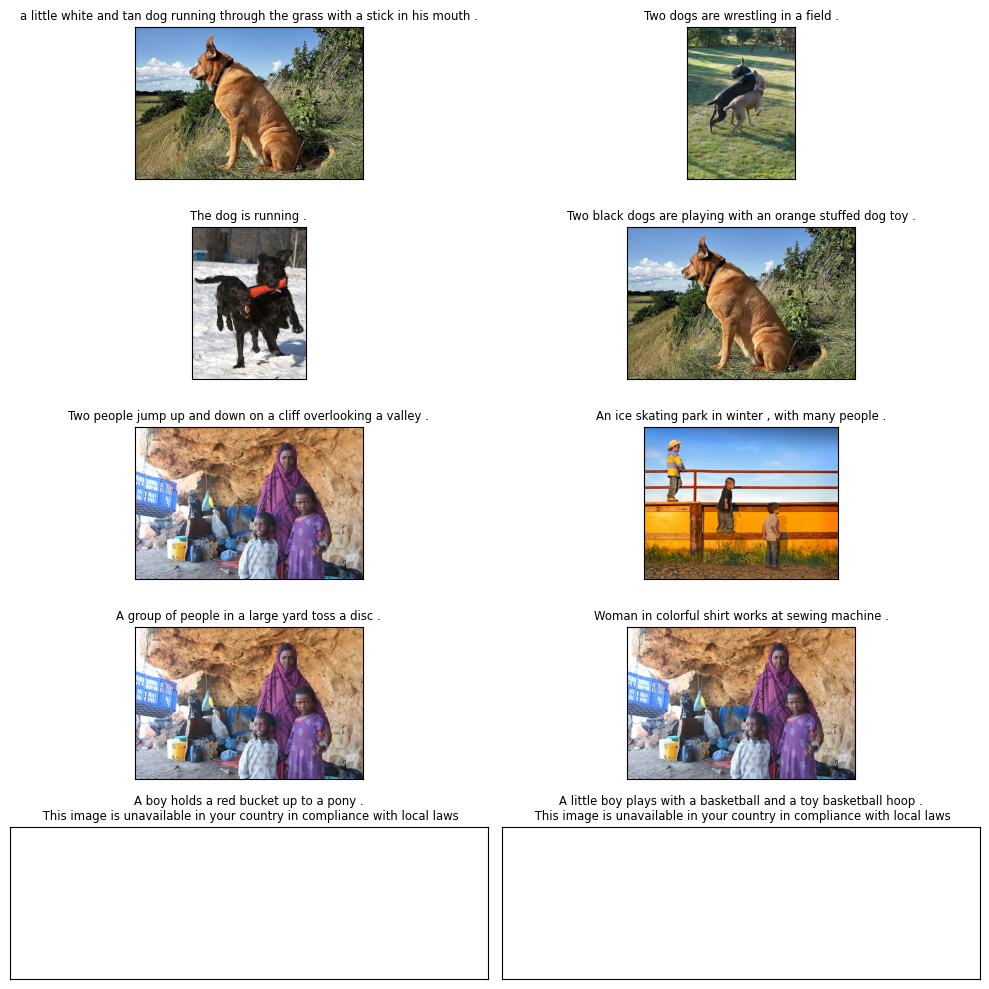

In [ ]:
# Выведем фото и описания на экран
fig = plt.figure(figsize=(10,10))
for i in range(queries_for_demo.shape[0]):
    fig.add_subplot(queries_for_demo.shape[0]//2, 2, i+1)
    query = queries_for_demo[i]
    img_file = proper_image(query)
    print()
    try:
        if img_file != 'is forbidden':
            image = \
            Image.open('/content/drive/MyDrive/Colab Notebooks/image_from_query/test_images/'+img_file).convert('RGB')
            plt.imshow(image)
    except:
        if img_file != 'is forbidden':
            image = \
            Image.open('test_images/'+img_file).convert('RGB')
            plt.imshow(image)
    if img_file != 'is forbidden':
        plt.title(query, fontsize='small')
    else:
        plt.title(query + '\n This image is unavailable in your country in compliance with local laws', fontsize='small')
    plt.xticks([])
    plt.yticks([])
plt.tight_layout()
plt.show()

Как видим, имеются точные совпадения, что говорит о принципиальной возможности осуществления сервиса поиска картинки по запросу. При этом есть и ошибки. В качестве мер по улучшению качества работы модели можно рассмотреть увеличение вектора изображения, более тонкую настройку нейронной сети, либо применить другие модели и подходы к векторизации.

## Выводы

В ходе проекта выполнено:
- загрузка и исследовательский анализ данных,
- проверены экспертные оценки и краудсорсинговые оценки,
- определена целевая переменная,
- из датасета исключены те объекты, которые выходят за рамки юридических ограничений,
- изображения векторизованы,
- текстовые запросы векторизованы,
- данные корректно разбиты на тренировочную и тестовую выборки,
- предложена метрика качества работы модели,
- предложена модель схожести изображений и текстового запроса,
- модель обучена,
- по итогам обучения модели сделаны выводы,
- проведено тестирование работы модели,
- по итогам тестирования визуально сравнили качество поиска.